# Seleção da Database
## Database: 
Brazilian E-Commerce Public Database by Olist
https://www.kaggle.com/olistbr/brazilian-ecommerce?select=olist_order_items_dataset.csv

### Descrição: 
A database foi provida pela Olist, uma empresa de marketplace situada no Brasil. A Olist conecta pequenos negócios por todo o Brasil de uma forma simples. Vendedores conseguem vender seus produtos diretamente pela Olist Store, as entregas são feitas por meio de parceiros.

### Problema de Negócio:
Quais são os principais fatores que alavancam o número de vendas? Quais os fatores que impactam na avaliação do cliente?

In [1]:
!pip install numpy==1.20 --user

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import re
import string
import nltk
import os
import folium
import mpl_toolkits
import plotly
import plotly.offline as pyoff
import plotly.graph_objs as go
import plotly.express as px
import chart_studio
import chart_studio.plotly as py
import holoviews as hv
import geoviews as gv
import datashader as ds

from warnings import simplefilter
from wordcloud import WordCloud
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from geopy.geocoders import Nominatim
from folium.plugins import HeatMap, FastMarkerCluster
from datetime import datetime, timedelta
from plotly.subplots import make_subplots
from colorcet import fire, rainbow, bgy, bjy, bkr, kb, kr
from datashader.colors import colormap_select, Greys9
from holoviews.streams import RangeXY
from holoviews.operation.datashader import datashade, dynspread, rasterize
from bokeh.io import push_notebook, show, output_notebook
from datashader.utils import lnglat_to_meters as webm
from datashader import transfer_functions as tf
from functools import partial
from datashader.utils import export_image
from IPython.display import HTML, display
import types

In [3]:
os.environ['PROJ_LIB'] = '/Users/herik/anaconda3/Library/share/proj'

In [4]:
# Versões dos pacotes usados neste jupyter notebook
%reload_ext watermark
%watermark -a "Herikc Brecher" --iversions

Author: Herikc Brecher

geoviews    : 1.9.5
pandas      : 1.4.2
holoviews   : 1.14.8
matplotlib  : 3.5.1
datashader  : 0.13.0
nltk        : 3.7
re          : 2.2.1
seaborn     : 0.11.2
numpy       : 1.20.0
folium      : 0.12.1.post1
plotly      : 5.6.0
chart_studio: 1.1.0



In [5]:
simplefilter(action='ignore', category=FutureWarning)
%matplotlib inline
pyoff.init_notebook_mode()
sns.set_theme()
display(HTML("<style>.container { width:100% !important; }</style>"))

Loading BokehJS ...

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
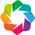

In [6]:
# Ambiente para Analise Geoespacial
output_notebook()
hv.extension('bokeh')

%opts Overlay [width=800 height=600 toolbar='above' xaxis=None yaxis=None]
%opts QuadMesh [tools=['hover'] colorbar=True] (alpha=0 hover_alpha=0.2)

T = 0.05
PX = 1

In [7]:
# Seed de Aleatoriedade
seed_ = 194
np.random.seed(seed_)

In [8]:
read_file = True

if read_file:
    try:
        with open('api.txt') as f:
            lines = f.readlines()

        # Ler usuario
        username = lines[0].split(':')[1].split('\n')[0]

        # Ler api key
        api_key = lines[1].split(':')[1]
    except:
        read_file = False

In [9]:
upload_to_dash_desejado = False

if read_file:
    # Configurando key para upar no dash do plotly
    chart_studio.tools.set_credentials_file(username=username, api_key=api_key)

    # Configurando Privacidade
    chart_studio.tools.set_config_file(world_readable = True, sharing = 'public')

    # Variavel para upar no dash
    upload_to_dash = upload_to_dash_desejado
else:
    upload_to_dash = False

# 1. Carregamento dos Dados

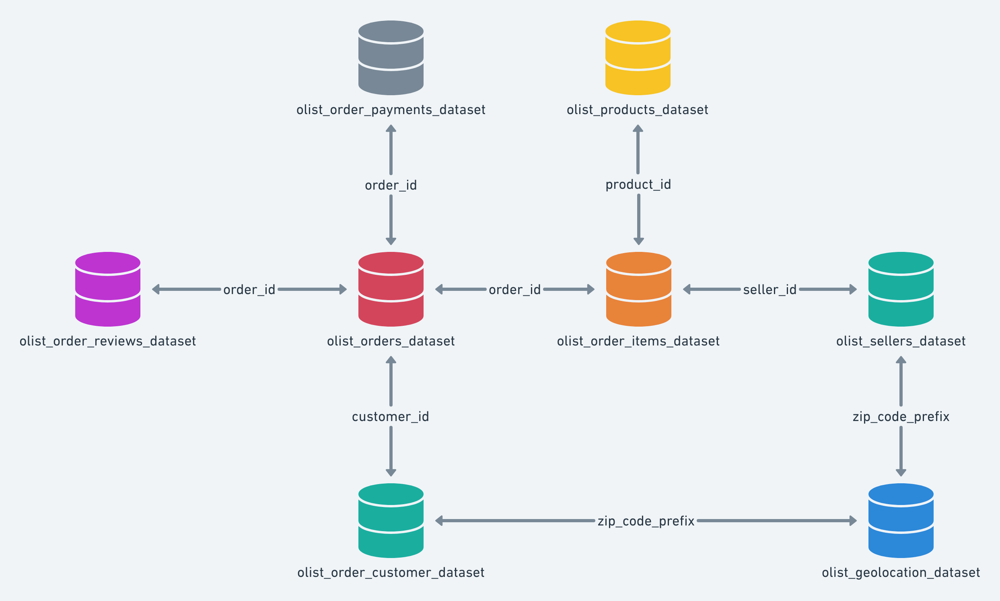

In [10]:
# Carregamento de todos datasets
dtCustomers = pd.read_csv('../data/olist_customers_dataset.csv', encoding = 'utf8', dtype={'customer_zip_code_prefix': str})
dtGeolocation = pd.read_csv('../data/olist_geolocation_dataset.csv', encoding = 'utf8', dtype={'geolocation_zip_code_prefix': str})
dtOrderItems = pd.read_csv('../data/olist_order_items_dataset.csv', encoding = 'utf8')
dtOrderPayments = pd.read_csv('../data/olist_order_payments_dataset.csv', encoding = 'utf8')
dtOrderReviews = pd.read_csv('../data/olist_order_reviews_dataset.csv', encoding = 'utf8')
dtOrders = pd.read_csv('../data/olist_orders_dataset.csv', encoding = 'utf8')
dtProducts = pd.read_csv('../data/olist_products_dataset.csv', encoding = 'utf8')
dtSellers = pd.read_csv('../data/olist_sellers_dataset.csv', encoding = 'utf8')
dtCategory = pd.read_csv('../data/product_category_name_translation.csv', encoding = 'utf8')

## 1.1 Adicionando Regiões de cada Estado

In [11]:
regioes = {
    'AC': 'Norte',
    'AL': 'Nordeste',
    'AP': 'Norte',
    'AM': 'Norte',
    'BA': 'Nordeste',
    'CE': 'Nordeste',
    'DF': 'CentroOeste',
    'ES': 'Sudeste',
    'GO': 'CentroOeste',
    'MA': 'Nordeste',
    'MT': 'CentroOeste',
    'MS': 'CentroOeste',
    'MG': 'Sudeste',
    'PA': 'Norte',
    'PB': 'Nordeste',
    'PR': 'Sul',
    'PE': 'Nordeste',
    'PI': 'Nordeste',
    'RJ': 'Sudeste',
    'RN': 'Nordeste',
    'RS': 'Sul',
    'RO': 'Norte',
    'RR': 'Norte',
    'SC': 'Sul',
    'SP': 'Sudeste',
    'SE': 'Nordeste',
    'TO': 'Norte'
}

In [12]:
dtCustomers['regiao'] =  dtCustomers['customer_state'].copy()

In [13]:
dtCustomers = dtCustomers.replace({'regiao': regioes})

In [14]:
dtCustomers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,regiao
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,Sudeste
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,Sudeste
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,Sudeste
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,Sudeste
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,Sudeste


In [15]:
dtSellers['regiao'] =  dtSellers['seller_state'].copy()

In [16]:
dtSellers = dtCustomers.replace({'regiao': regioes})

In [17]:
dtSellers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,regiao
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,Sudeste
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,Sudeste
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,Sudeste
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,Sudeste
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,Sudeste


In [18]:
dtGeolocation['regiao'] =  dtGeolocation['geolocation_state'].copy()

In [19]:
dtGeolocation = dtGeolocation.replace({'regiao': regioes})

In [20]:
dtGeolocation.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,regiao
0,01037,-23.545621,-46.639292,sao paulo,SP,Sudeste
1,01046,-23.546081,-46.644820,sao paulo,SP,Sudeste
2,01046,-23.546129,-46.642951,sao paulo,SP,Sudeste
3,01041,-23.544392,-46.639499,sao paulo,SP,Sudeste
4,01035,-23.541578,-46.641607,sao paulo,SP,Sudeste


# 2. Analise Exploratória

In [21]:
# Dataset de pedidos
dtOrders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [22]:
dtOrders.dtypes

order_id                         object
customer_id                      object
order_status                     object
order_purchase_timestamp         object
order_approved_at                object
order_delivered_carrier_date     object
order_delivered_customer_date    object
order_estimated_delivery_date    object
dtype: object

In [23]:
# Colunas do tipo data
dateColumns = ['order_purchase_timestamp', 'order_approved_at', 'order_delivered_carrier_date',\
               'order_delivered_customer_date', 'order_estimated_delivery_date']

# Dataset de analise temporal
dtOrdersAjustado = dtOrders.copy()

In [24]:
# Convertendo columas de data para date
for col in dateColumns:
    dtOrdersAjustado[col] = pd.to_datetime(dtOrdersAjustado[col], format = '%Y-%m-%d %H:%M:%S')

In [25]:
dtOrdersAjustado.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26


In [26]:
dtOrdersAjustado.dtypes

order_id                                 object
customer_id                              object
order_status                             object
order_purchase_timestamp         datetime64[ns]
order_approved_at                datetime64[ns]
order_delivered_carrier_date     datetime64[ns]
order_delivered_customer_date    datetime64[ns]
order_estimated_delivery_date    datetime64[ns]
dtype: object

In [27]:
# Verificando tipos unicos
print(dtOrdersAjustado.nunique())

order_id                         99441
customer_id                      99441
order_status                         8
order_purchase_timestamp         98875
order_approved_at                90733
order_delivered_carrier_date     81018
order_delivered_customer_date    95664
order_estimated_delivery_date      459
dtype: int64


In [28]:
# Verificando columas com null
print(dtOrdersAjustado.isna().sum())

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64


Verificamos que possuem valores NA no dataset. Abaixo iremos verificar que possuem apenas 2980 observações como NA. Por essas representaem um valor pequeno do dataset iremos removelas. 

In [29]:
# Verificando valores NA
dtOrdersAjustado[dtOrdersAjustado.isna().any(axis = 1)]

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,NaT,NaT,2017-05-09
44,ee64d42b8cf066f35eac1cf57de1aa85,caded193e8e47b8362864762a83db3c5,shipped,2018-06-04 16:44:48,2018-06-05 04:31:18,2018-06-05 14:32:00,NaT,2018-06-28
103,0760a852e4e9d89eb77bf631eaaf1c84,d2a79636084590b7465af8ab374a8cf5,invoiced,2018-08-03 17:44:42,2018-08-07 06:15:14,NaT,NaT,2018-08-21
128,15bed8e2fec7fdbadb186b57c46c92f2,f3f0e613e0bdb9c7cee75504f0f90679,processing,2017-09-03 14:22:03,2017-09-03 14:30:09,NaT,NaT,2017-10-03
154,6942b8da583c2f9957e990d028607019,52006a9383bf149a4fb24226b173106f,shipped,2018-01-10 11:33:07,2018-01-11 02:32:30,2018-01-11 19:39:23,NaT,2018-02-07
...,...,...,...,...,...,...,...,...
99283,3a3cddda5a7c27851bd96c3313412840,0b0d6095c5555fe083844281f6b093bb,canceled,2018-08-31 16:13:44,NaT,NaT,NaT,2018-10-01
99313,e9e64a17afa9653aacf2616d94c005b8,b4cd0522e632e481f8eaf766a2646e86,processing,2018-01-05 23:07:24,2018-01-09 07:18:05,NaT,NaT,2018-02-06
99347,a89abace0dcc01eeb267a9660b5ac126,2f0524a7b1b3845a1a57fcf3910c4333,canceled,2018-09-06 18:45:47,NaT,NaT,NaT,2018-09-27
99348,a69ba794cc7deb415c3e15a0a3877e69,726f0894b5becdf952ea537d5266e543,unavailable,2017-08-23 16:28:04,2017-08-28 15:44:47,NaT,NaT,2017-09-15


In [30]:
# Dropando valores NA
dtOrdersAjustado = dtOrdersAjustado.dropna()

In [31]:
# Verificando se possuem valores duplicados
print(sum(dtOrdersAjustado.duplicated()))

0


In [32]:
dtOrdersAjustado.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26


In [33]:
# Dataframe all
dtAll = dtOrders.merge(dtCustomers, on="customer_id").merge(dtOrderItems, on="order_id").merge(dtProducts, on="product_id").merge(dtCategory, on="product_category_name").merge(dtOrderPayments, on="order_id").merge(dtOrderReviews, on="order_id")

In [34]:
dtOrdersMesAno = dtOrdersAjustado.copy()

# Mantendo somente Ano e Mes
for col in dateColumns:
    dtOrdersMesAno[col] = pd.to_datetime(dtOrdersMesAno[col], format = '%Y-%m-%d %H:%M:%S').dt.to_period('M')

In [35]:
dtOrdersMesAno.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10,2017-10,2017-10,2017-10,2017-10
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07,2018-07,2018-07,2018-08,2018-08
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08,2018-08,2018-08,2018-08,2018-09
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11,2017-11,2017-11,2017-12,2017-12
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02,2018-02,2018-02,2018-02,2018-02


## 2.1 Evolução das Vendas Mensais

Analisando o grafico abaixo é perceptivel que entre 2017 e Janeiro de 2018 tivemos uma alavancagem nas vendas. Estabilizou no inicio de 2018 entre 6 e 7 mil vendas.

In [36]:
dtFiltrado = dtOrdersMesAno.groupby('order_approved_at').count()['order_id'].to_frame().reset_index()

In [37]:
dtFiltrado['order_approved_at'] = dtFiltrado['order_approved_at'].astype(str)

In [38]:
# Plot

# Definição dos dados no plot
plot_data = [go.Scatter(x = dtFiltrado['order_approved_at'],
y = dtFiltrado['order_id'])]

# Layout
plot_layout = go.Layout(xaxis = {"type": "category", "title": "Periodo"},
                        yaxis = {"title": "Vendas"},
                        title = 'Evolução das Vendas Mensais')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)

fig.add_annotation(
        x = 13,
        y = 7149,
        xref="x",
        yref="y",
        text="Máximo de Vendas",
        showarrow = True,
        font=dict(
            family="Courier New, monospace",
            size=16,
            color="#636363"
            ),
        align="center",
        arrowhead=2,
        arrowsize=1,
        arrowwidth=2,
        arrowcolor="#636363",
        ax=20,
        ay=-30,
        bordercolor="#636363",
        borderwidth=1.5,
        borderpad=4,
        bgcolor="#fff",
        opacity=1
        )

pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'evolucao_vendas_mensais', auto_open = False)

## 2.2 Evolução Faturamento Mensal

In [39]:
dtOrderPrice = dtOrderItems.groupby('order_id').agg({'price': sum}).reset_index()

In [40]:
dtOrderPrice.head()

,order_id,price
0,00010242fe8c5a6d1ba2dd792cb16214,58.90
1,00018f77f2f0320c557190d7a144bdd3,239.90
2,000229ec398224ef6ca0657da4fc703e,199.00
3,00024acbcdf0a6daa1e931b038114c75,12.99
4,00042b26cf59d7ce69dfabb4e55b4fd9,199.90


In [41]:
dtFaturamentoMesAno = pd.merge(dtOrdersMesAno, dtOrderPrice, on = 'order_id')

In [42]:
dtFaturamentoMesAno.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,price
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10,2017-10,2017-10,2017-10,2017-10,29.99
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07,2018-07,2018-07,2018-08,2018-08,118.70
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08,2018-08,2018-08,2018-08,2018-09,159.90
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11,2017-11,2017-11,2017-12,2017-12,45.00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02,2018-02,2018-02,2018-02,2018-02,19.90


In [43]:
dtFiltrado = dtFaturamentoMesAno.groupby('order_approved_at').agg({'price': sum}).reset_index()

In [44]:
dtFiltrado['order_approved_at'] = dtFiltrado['order_approved_at'].astype(str)

In [45]:
dtFiltrado.head()

,order_approved_at,price
0,2016-09,134.97
1,2016-10,40941.30
2,2016-12,10.90
3,2017-01,106888.10
4,2017-02,234163.38


In [46]:
# Plot

# Definição dos dados no plot
plot_data = [go.Scatter(x = dtFiltrado['order_approved_at'], 
                        y = dtFiltrado['price'])]

# Layout
plot_layout = go.Layout(xaxis = {"type": "category", 'title': 'Periodo'},
                        yaxis = {"title": 'Faturamento'},
                        title = 'Evolução Faturamento Mensal')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)


fig.add_annotation(
        x = 19,
        y = 999867,
        xref="x",
        yref="y",
        text="Máximo de Faturamento",
        showarrow = True,
        font=dict(
            family="Courier New, monospace",
            size=16,
            color="#000"
            ),
        align="center",
        arrowhead=2,
        arrowsize=1,
        arrowwidth=2,
        arrowcolor="#636363",
        ax=20,
        ay=-30,
        bordercolor="#636363",
        borderwidth=1.5,
        borderpad=4,
        bgcolor="#fff",
        opacity=1
        )

pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'evolucao_faturamento_mensal', auto_open = False)

## 2.3 Faturamento Mensal 2017 Vs 2018

In [47]:
months = {
            '01': 'Janeiro',
            '02': 'Fevereiro',
            '03': 'Março',
            '04': 'Abril',
            '05': 'Maio',
            '06': 'Junho',
            '07': 'Julho',
            '08': 'Agosto',
            '09': 'Setembro',
            '10': 'Outubro',
            '11': 'Novembro',
            '12': 'Dezembro'        
        }

In [48]:
dtFiltrado2017 = dtFiltrado.copy()
dtFiltrado2017 = dtFiltrado2017.query("'2017-01' <= order_approved_at <= '2017-08'")

In [49]:
dtFiltrado2017['order_approved_at'] = dtFiltrado2017['order_approved_at'].apply(lambda x: x[5:])

In [50]:
dtFiltrado2017 = dtFiltrado2017.replace({'order_approved_at': months})

In [51]:
dtFiltrado2017.columns = ['Mes-2017', 'Faturamento-2017']

In [52]:
dtFiltrado2017 = dtFiltrado2017.reset_index()
dtFiltrado2017 = dtFiltrado2017.drop('index', axis = 1)

In [53]:
dtFiltrado2017.head()

,Mes-2017,Faturamento-2017
0,Janeiro,106888.10
1,Fevereiro,234163.38
2,Março,355372.21
3,Abril,338207.85
4,Maio,490517.21


In [54]:
dtFiltrado2018 = dtFiltrado.copy()
dtFiltrado2018 = dtFiltrado2018.query("'2018-01' <= order_approved_at <= '2018-08'")

In [55]:
dtFiltrado2018['order_approved_at'] = dtFiltrado2018['order_approved_at'].apply(lambda x: x[5:])

In [56]:
dtFiltrado2018 = dtFiltrado2018.replace({'order_approved_at': months})

In [57]:
dtFiltrado2018.columns = ['Mes-2018', 'Faturamento-2018']

In [58]:
dtFiltrado2018 = dtFiltrado2018.reset_index()
dtFiltrado2018 = dtFiltrado2018.drop('index', axis = 1)

In [59]:
dtFaturamento2017To2018 = pd.concat([dtFiltrado2017, dtFiltrado2018], axis = 1)

In [60]:
dtFaturamento2017To2018['crescimento-2017-para-2018'] = dtFaturamento2017To2018.apply( lambda x: str( round((x[3] / x[1]) * 100, 2)), axis = 1 )

In [61]:
dtFaturamento2017To2018['crescimento-2017-para-2018'] =  dtFaturamento2017To2018.apply(lambda x: '+' + x[4] + '%' if x[3] > x[1] else '-' + x[4] + '%', axis = 1 )

In [62]:
dtFaturamento2017To2018

,Mes-2017,Faturamento-2017,Mes-2018,Faturamento-2018,crescimento-2017-para-2018
0,Janeiro,106888.10,Janeiro,917667.20,+858.53%
1,Fevereiro,234163.38,Fevereiro,819385.26,+349.92%
2,Março,355372.21,Março,963604.25,+271.15%
3,Abril,338207.85,Abril,953526.94,+281.94%
4,Maio,490517.21,Maio,999867.28,+203.84%
5,Junho,425825.55,Junho,859396.90,+201.82%
6,Julho,476556.89,Julho,849351.12,+178.23%
7,Agosto,555061.46,Agosto,862639.54,+155.41%


In [63]:
# Plot

# Definição dos dados no plot
plot_data = [go.Bar(name = '2017', x = dtFaturamento2017To2018['Mes-2017'], y = dtFaturamento2017To2018['Faturamento-2017']),
             go.Bar(name = '2018', x = dtFaturamento2017To2018['Mes-2018'], y = dtFaturamento2017To2018['Faturamento-2018'], text = dtFaturamento2017To2018['crescimento-2017-para-2018'], textposition = 'outside')]

# Layout
plot_layout = go.Layout(xaxis = {'title': 'Periodo'},
                        yaxis = {"title": 'Faturamento'},
                        barmode = 'group',
                        title = 'Faturamento Mensal 2017 Vs 2018')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)

pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'faturamento_mensal_2017_vs_2018', auto_open = False)

### 2.4 Taxa Percentual de Crescimento Mensal

In [64]:
# Calculando crescimento Mensal
dtFiltrado['MonthlyGrowth'] = dtFiltrado['price'].pct_change()

In [65]:
dtFiltrado.head()

,order_approved_at,price,MonthlyGrowth
0,2016-09,134.97,NaN
1,2016-10,40941.30,302.336297
2,2016-12,10.90,-0.999734
3,2017-01,106888.10,9805.247706
4,2017-02,234163.38,1.190734


In [66]:
# Plot

# Definição dos dados no plot (Iniciando em Fevereiro de 2017 para não destorcer os dados)
plot_data = [go.Scatter(x = dtFiltrado.query("order_approved_at > '2017-01'")['order_approved_at'],
                        y = dtFiltrado.query("order_approved_at > '2017-01'")['MonthlyGrowth'])]

# Layout
plot_layout = go.Layout(xaxis = {"type": "category", 'title': 'Periodo'},
                        yaxis = {"title": 'Crescimento em Porcentagem'},
                        title = 'Taxa Percentual de Crescimento Mensal')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)

fig.add_annotation(
        x = 0,
        y = 1.2,
        xref="x",
        yref="y",
        text="Crescimento Residual",
        showarrow = True,
        font=dict(
            family="Courier New, monospace",
            size=16,
            color="#000"
            ),
        align="center",
        arrowhead=2,
        arrowsize=1,
        arrowwidth=2,
        arrowcolor="#636363",
        ax=20,
        ay=-30,
        bordercolor="#636363",
        borderwidth=1.5,
        borderpad=4,
        bgcolor="#fff",
        opacity=1
        )

fig.add_annotation(
        x = 9,
        y = 0.49,
        xref="x",
        yref="y",
        text="Maior Taxa de Crescimento",
        showarrow = True,
        font=dict(
            family="Courier New, monospace",
            size=16,
            color="#000"
            ),
        align="center",
        arrowhead=2,
        arrowsize=1,
        arrowwidth=2,
        arrowcolor="#636363",
        ax=20,
        ay=-30,
        bordercolor="#636363",
        borderwidth=1.5,
        borderpad=4,
        bgcolor="#fff",
        opacity=1
        )

pyoff.iplot(fig) 

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'taxa_percentual_crescimento_brasil', auto_open = False)

## 2.5 Existe diferença significativa de venda para cada um dos meses?

Conforme a analise abaixo é perceptivel que ao longo do ano de 2017, apesar de possuirem algumas oscilações, as vendas se mantiveram crescentes. Conforme se aproxima das datas festivas no mes de dezembro (12) as vendas tendem a crescer com maior intensidade. Porém, apesar da analise inicial, não é possível afirmar que os meses tem impacto em relação as vendas, para isso precisariamos de um historico maior de vendas ao longo de mais anos.

Além disso, seria necessário realizar testes estatisticos que nao serão realizadas devido a falta de necessidade na base atual.

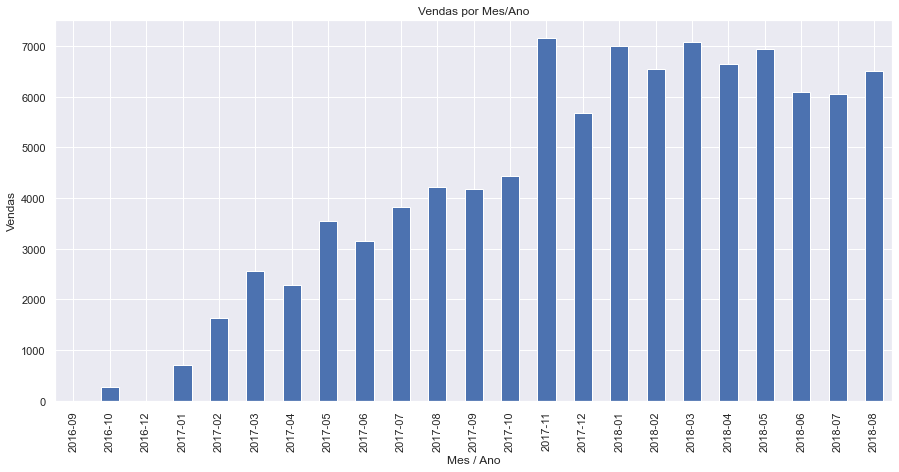

In [67]:
plt.figure(figsize = (15, 7))
dtOrdersMesAno.groupby('order_approved_at').count()['order_id'].plot(kind = 'bar')

plt.xlabel('Mes / Ano')
plt.ylabel('Vendas')
plt.title('Vendas por Mes/Ano')

plt.show()

## 2.6 Existe diferença significativa de venda para cada um dos dias da semana?

### 2.6.1 Total de Vendas por Dia da Semana

In [68]:
# Criando copia dataset ajustado
dtOrdersMesAnoDia = dtOrdersAjustado[['order_id', 'order_approved_at']].copy()

In [69]:
dtOrdersMesAnoDia['weekday'] = dtOrdersMesAnoDia['order_approved_at'].dt.dayofweek

In [70]:
dtOrdersMesAnoDia.head()

,order_id,order_approved_at,weekday
0,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 11:07:15,0
1,53cdb2fc8bc7dce0b6741e2150273451,2018-07-26 03:24:27,3
2,47770eb9100c2d0c44946d9cf07ec65d,2018-08-08 08:55:23,2
3,949d5b44dbf5de918fe9c16f97b45f8a,2017-11-18 19:45:59,5
4,ad21c59c0840e6cb83a9ceb5573f8159,2018-02-13 22:20:29,1


In [71]:
# Mantendo somente Ano, Mes e Dia
dtOrdersMesAnoDia['order_approved_at'] = pd.to_datetime(dtOrdersMesAnoDia['order_approved_at'],\
                                                        format = '%Y-%m-%d %H:%M:%S').dt.to_period('y')

In [72]:
dtOrdersMesAnoDia.head()

,order_id,order_approved_at,weekday
0,e481f51cbdc54678b7cc49136f2d6af7,2017,0
1,53cdb2fc8bc7dce0b6741e2150273451,2018,3
2,47770eb9100c2d0c44946d9cf07ec65d,2018,2
3,949d5b44dbf5de918fe9c16f97b45f8a,2017,5
4,ad21c59c0840e6cb83a9ceb5573f8159,2018,1


In [73]:
dtFiltrado = dtOrdersMesAnoDia.groupby('weekday').count()['order_id'].reset_index()

In [74]:
dtFiltrado['percent'] = dtFiltrado['order_id'].apply(lambda x: str( round(x / sum(dtFiltrado['order_id']) * 100, 2) ) + '%')

In [75]:
# Plot

# Definição dos dados no plot
labels = ['Domingo', 'Segunda', 'Terça', 'Quarta', 'Quinta', 'Sexta', 'Sabado']
plot_data = [go.Bar(x = labels, 
                    y = dtFiltrado['order_id'],
                    text = dtFiltrado['percent'], textposition = 'outside')] #, textfont=dict(color='#E58606')

# Layout
plot_layout = go.Layout(xaxis = {"type": "category", 'title': 'Dia da Semana'},
                        yaxis = {'title': 'Vendas'},
                        title = 'Total de Vendas por Dia da Semana')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)
pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'total_vendas_dia_semana', auto_open = False)

### 2.6.2 Total de Vendas por Dia da Semana por Ano

In [76]:
dtOrdersMesAnoDia2016 = dtOrdersMesAnoDia[dtOrdersMesAnoDia['order_approved_at'] == '2016'].groupby('weekday').\
count()['order_id']
dtOrdersMesAnoDia2017 = dtOrdersMesAnoDia[dtOrdersMesAnoDia['order_approved_at'] == '2017'].groupby('weekday').\
count()['order_id']
dtOrdersMesAnoDia2018 = dtOrdersMesAnoDia[dtOrdersMesAnoDia['order_approved_at'] == '2018'].groupby('weekday').\
count()['order_id']

In [77]:
dtOrdersMesAnoDiaAgrupado = dtOrdersMesAnoDia.groupby(['order_approved_at', 'weekday']).count().reset_index()

In [78]:
dtOrdersMesAnoDiaAgrupado.columns = ['year', 'weekday', 'orders']

In [79]:
dtOrdersMesAnoDiaAgrupado['year'] = dtOrdersMesAnoDiaAgrupado['year'].astype(str)

In [80]:
dtOrdersMesAnoDiaAgrupado

,year,weekday,orders
0,2016,0,40
1,2016,1,44
2,2016,2,11
3,2016,3,97
4,2016,4,48
5,2016,5,23
6,2016,6,9
7,2017,0,5285
8,2017,1,8096
9,2017,2,6971


In [81]:
dtOrdersMesAnoDiaPivot = dtOrdersMesAnoDiaAgrupado.pivot(index = 'weekday', columns = 'year')['orders'].reset_index()

In [82]:
dtOrdersMesAnoDiaPivot['weekday'] = dtOrdersMesAnoDiaPivot['weekday'].astype(str)

In [83]:
labels_ = {'0': 'Domingo', '1': 'Segunda', '2': 'Terça', '3': 'Quarta', '4': 'Quinta', '5': 'Sexta', '6': 'Sabado'}

In [84]:
dtOrdersMesAnoDiaPivot = dtOrdersMesAnoDiaPivot.replace({'weekday': labels_})

In [85]:
dtOrdersMesAnoDiaPivot.head()

year,weekday,2016,2017,2018
0,Domingo,40,5285,7290
1,Segunda,44,8096,10504
2,Terça,11,6971,8348
3,Quarta,97,6399,8549
4,Quinta,48,6582,7588


In [86]:
fig = px.bar(dtOrdersMesAnoDiaPivot,\
             x = "weekday", y = ['2016', '2017', '2018'], title = "Total de Vendas por Dia da Semana por Ano", labels = {'variable': 'Ano', 'value': 'Vendas', 'weekday': 'Dia da Semana'})
fig.show()

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'total_vendas_dia_semana_por_ano', auto_open = False)

### 2.6.3 Média de Vendas por Dia da Semana por Ano

In [87]:
# Criando copia para novo dataset
dtOrdersDiaMesAno = dtOrdersAjustado[['order_id', 'order_approved_at']].copy()

# Mantendo somente Ano, Mes e Dia
dtOrdersDiaMesAno['Data'] = \
    pd.to_datetime(dtOrdersDiaMesAno['order_approved_at'], format = '%Y-%m-%d %H:%M:%S').dt.to_period('d')

In [88]:
# Criandop coluna de Ano
dtOrdersDiaMesAno['Ano'] = \
    pd.to_datetime(dtOrdersDiaMesAno['order_approved_at'], format = '%Y-%m-%d %H:%M:%S').dt.to_period('y')

In [89]:
# Criando coluna de weekday
dtOrdersDiaMesAno['weekday'] = dtOrdersDiaMesAno['order_approved_at'].dt.dayofweek

In [90]:
dtOrdersDiaMesAno.head()

,order_id,order_approved_at,Data,Ano,weekday
0,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 11:07:15,2017-10-02,2017,0
1,53cdb2fc8bc7dce0b6741e2150273451,2018-07-26 03:24:27,2018-07-26,2018,3
2,47770eb9100c2d0c44946d9cf07ec65d,2018-08-08 08:55:23,2018-08-08,2018,2
3,949d5b44dbf5de918fe9c16f97b45f8a,2017-11-18 19:45:59,2017-11-18,2017,5
4,ad21c59c0840e6cb83a9ceb5573f8159,2018-02-13 22:20:29,2018-02-13,2018,1


In [91]:
def cria_media_semanal_por_ano(data, ano):
    dtAnoDia = data[data['Ano'] == ano].groupby('weekday').nunique()
    dtAnoDia['mean_orders'] = dtAnoDia.apply(lambda x: int(x['order_id'] / x['Data']), axis = 1)
    dtAnoDia = dtAnoDia['mean_orders'].reset_index()
    dtAnoDia['year'] = ano
    dtAnoDia = dtAnoDia.pivot(index = 'weekday', columns = 'year')['mean_orders'].reset_index()
    
    return dtAnoDia

In [92]:
# Calcula media de vendas por dia da semana do ano de 2016
dtOrdersDiaMesAno2016 = cria_media_semanal_por_ano(dtOrdersDiaMesAno, '2016')

In [93]:
# Calcula media de vendas por dia da semana do ano de 2017
dtOrdersDiaMesAno2017 = cria_media_semanal_por_ano(dtOrdersDiaMesAno, '2017')

In [94]:
# Calcula media de vendas por dia da semana  do ano de 2018
dtOrdersDiaMesAno2018 = cria_media_semanal_por_ano(dtOrdersDiaMesAno, '2018')

In [95]:
dtOrdersDiaMesAno2016

year,weekday,2016
0,0,40
1,1,22
2,2,5
3,3,32
4,4,24
5,5,23
6,6,9


In [96]:
# Concatenando coluna de cada ano
dtOrdersDiaMesAnoPivot = dtOrdersDiaMesAno2016.copy()
dtOrdersDiaMesAnoPivot['2017'] = dtOrdersDiaMesAno2017['2017']
dtOrdersDiaMesAnoPivot['2018'] = dtOrdersDiaMesAno2018['2018']

In [97]:
dtOrdersDiaMesAnoPivot['weekday'] = dtOrdersDiaMesAnoPivot['weekday'].astype(str)

In [98]:
dtOrdersDiaMesAnoPivot = dtOrdersDiaMesAnoPivot.replace({'weekday': labels_})

In [99]:
dtOrdersDiaMesAnoPivot

year,weekday,2016,2017,2018
0,Domingo,40,103,214
1,Segunda,22,158,300
2,Terça,5,136,245
3,Quarta,32,123,251
4,Quinta,24,126,223
5,Sexta,23,109,184
6,Sabado,9,82,139


In [100]:
fig = px.bar(dtOrdersDiaMesAnoPivot,\
             x = "weekday", y = ['2016', '2017', '2018'], title = "Média de Vendas por Dia da Semana por Ano", labels = {'variable': 'Ano', 'value': 'Vendas', 'weekday': 'Dia da Semana'})
fig.show()

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'media_vendas_dia_semana_ano', auto_open = False)

## 2.7 Existe diferença significativa de venda para cada um dos periodos do dia?

Para definirmos o periodo do dia iremos seguir a seguinte relação:
- Manhã: 6:00 às 11:59
- Tarde: 12:00 (Meio-dia) às 17:59
- Noite 18:00 às 23:59
- Madrugada: 00:00 (Meia-noite) às 05:59

### 2.7.1 Total de Vendas por Período do Dia

In [101]:
dtOrdersAjustado.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26


In [102]:
dtOrdersDelivered = dtOrdersAjustado[dtOrdersAjustado['order_status'] == 'delivered'].copy()

In [103]:
dtOrdersDelivered.dtypes

order_id                                 object
customer_id                              object
order_status                             object
order_purchase_timestamp         datetime64[ns]
order_approved_at                datetime64[ns]
order_delivered_carrier_date     datetime64[ns]
order_delivered_customer_date    datetime64[ns]
order_estimated_delivery_date    datetime64[ns]
dtype: object

In [104]:
def parteDia(hour):
    value = 'Madrugada'
    
    if 6 <= hour <= 11:
        value = 'Manhã'
    elif 12 <= hour <= 17:
        value = 'Tarde'
    elif 18 <= hour <= 23:
        value = 'Noite'
        
    return value

In [105]:
dtOrdersDelivered['purchase_part_day'] = dtOrdersDelivered['order_purchase_timestamp'].apply(lambda x: parteDia(x.hour)) 

In [106]:
dtOrdersDelivered.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,purchase_part_day
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,Manhã
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,Noite
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,Manhã
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,Noite
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,Noite


In [107]:
dtFiltrado = dtOrdersDelivered.groupby('purchase_part_day').count()['order_id'].reset_index()

In [108]:
dtFiltrado['percent'] = dtFiltrado['order_id'].apply(lambda x: str( round(x / sum(dtFiltrado['order_id']) * 100, 2) ) + '%')

In [109]:
dtFiltrado.head()

,purchase_part_day,order_id,percent
0,Madrugada,4593,4.76%
1,Manhã,21591,22.38%
2,Noite,33102,34.32%
3,Tarde,37169,38.54%


In [110]:
# Plot

# Definição dos dados no plot
plot_data = [go.Bar(x = dtFiltrado['purchase_part_day'],
                    y = dtFiltrado['order_id'],
                    text = dtFiltrado['percent'], textposition = 'outside')]

# Layout
plot_layout = go.Layout(xaxis = {"type": "category", 'title': 'Periodo do Dia'}, 
                        yaxis = {'title': 'Vendas'}, 
                        title = 'Total de Vendas por Período do Dia')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)
pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'total_vendas_periodo_dia', auto_open = False)

## 2.8 Existe diferença significativa de venda para cada um dos metodos de pagamento?

### 2.8.1 Métodos de Pagamentos

In [111]:
dtOrderPayments.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [112]:
dtOrderPayments.groupby('payment_type').count()

,order_id,payment_sequential,payment_installments,payment_value
payment_type,,,,
boleto,19784,19784,19784,19784
credit_card,76795,76795,76795,76795
debit_card,1529,1529,1529,1529
not_defined,3,3,3,3
voucher,5775,5775,5775,5775


In [113]:
dtOrderPayments = dtOrderPayments[dtOrderPayments['payment_type'] != 'not_defined']

In [114]:
dtOrderPayments.groupby('payment_type').count()

,order_id,payment_sequential,payment_installments,payment_value
payment_type,,,,
boleto,19784,19784,19784,19784
credit_card,76795,76795,76795,76795
debit_card,1529,1529,1529,1529
voucher,5775,5775,5775,5775


In [115]:
# Definição dos dados no plot
labels = ['Boleto', 'Cartão de Crédito', 'Cartão de Débito', 'Voucher']
values = dtOrderPayments.groupby('payment_type').count()['order_id']

plot_data = [go.Pie(labels = labels, values = values, hole = .3, pull = [0, .1, 0, 0], name = 'Pagamentos')]

# Layout
plot_layout = go.Layout(title = 'Métodos de Pagamentos', annotations = [dict(text='Meios de Pagamento', x = 1.2, y = 1.08, font_size = 18, showarrow = False)])

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)
pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'metodos_pagamentos', auto_open = False)

## 2.9 Existe diferença significativa de venda por região?

### 2.9.1 Total de Vendas por Estado no Brasil

In [116]:
dtCustomers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,regiao
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,Sudeste
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,Sudeste
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,Sudeste
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,Sudeste
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,Sudeste


In [117]:
salesState = dtCustomers.groupby('customer_state')['customer_id'].count()

In [118]:
salesState = salesState.sort_values(ascending = False).reset_index()

In [119]:
salesState['percent'] = salesState['customer_id'].apply(lambda x: str( round(x / sum(salesState['customer_id']) * 100, 2) ) + '%')

In [120]:
salesState.head()

,customer_state,customer_id,percent
0,SP,41746,41.98%
1,RJ,12852,12.92%
2,MG,11635,11.7%
3,RS,5466,5.5%
4,PR,5045,5.07%


In [121]:
# Plot

# Definição dos dados no plot
plot_data = [go.Bar(x = salesState['customer_state'], 
                    y = salesState['customer_id'],
                    text = salesState['percent'], textposition = 'outside')]

# Layout
plot_layout = go.Layout(xaxis = {"type": "category", 'title': 'Estados'},
                        yaxis = {'title': 'Vendas'},
                        title = 'Total de Vendas por Estado no Brasil')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)
pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'total_vendas_estado_brasil', auto_open = False)

### 2.9.2 Total de Vendas por Região no Brasil

In [122]:
salesRegiao = dtCustomers.groupby('regiao')['customer_id'].count().reset_index()

In [123]:
salesRegiao['percent'] = salesRegiao['customer_id'].apply(lambda x: str( round(x / sum(salesRegiao['customer_id']) * 100, 2) ) + '%')

In [124]:
salesRegiao['percent_number'] = salesRegiao['customer_id'].apply(lambda x: round(x / sum(salesRegiao['customer_id']) * 100, 2) )

In [125]:
salesRegiao = salesRegiao.sort_values('percent_number', ascending  = False)

In [126]:
salesRegiao

,regiao,customer_id,percent,percent_number
3,Sudeste,68266,68.65%,68.65
4,Sul,14148,14.23%,14.23
1,Nordeste,9394,9.45%,9.45
0,CentroOeste,5782,5.81%,5.81
2,Norte,1851,1.86%,1.86


In [127]:
# Plot

# Definição dos dados no plot
plot_data = [go.Bar(x = salesRegiao['regiao'], 
                    y = salesRegiao['customer_id'],
                    text = salesRegiao['percent'], textposition = 'outside')]

# Layout
plot_layout = go.Layout(xaxis = {"type": "category", 'title': 'Regiões'},
                        yaxis = {'title': 'Vendas'},
                        title = 'Total de Vendas por Região no Brasil')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)
pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'total_vendas_regiao_brasil', auto_open = False)

### 2.9.3 Top 10 Cidades com Maior Numero de Vendas

In [128]:
salesCidade = dtCustomers.groupby('customer_city')['customer_id'].count()

In [129]:
salesCidade10 = salesCidade.sort_values(ascending = False).reset_index().head(10)

In [130]:
salesCidade = salesCidade.reset_index()

In [131]:
salesCidade10['percent'] = salesCidade10['customer_id'].apply(lambda x: str( round(x / sum(salesCidade['customer_id']) * 100, 2) ) + '%')

In [132]:
salesCidade10 = salesCidade10.sort_values(ascending = True, by = 'customer_id')

In [133]:
# Plot

# Definição dos dados no plot
plot_data = [go.Bar(y = salesCidade10['customer_city'], 
                    x = salesCidade10['customer_id'], orientation = 'h',
                    text = salesCidade10['percent'], textposition = 'outside')]

# Layout
plot_layout = go.Layout(yaxis = {"type": "category", 'title': 'Cidades'},
                        xaxis = {'title': 'Vendas'},
                        title = 'Top 10 Cidades com Maior Numero de Vendas')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)
pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'top_10_cidades_vendas', auto_open = False)

### 2.9.4 % Contribuição Cumulativa das Vendas nas Cidades

In [134]:
topRevenueByCity = dtAll.groupby("customer_city")["payment_value"].sum().reset_index().sort_values("payment_value", ascending=False)
topRevenueByCity["% of Total Payments"] = (topRevenueByCity["payment_value"] / topRevenueByCity["payment_value"].sum()) * 100
topRevenueByCity["% Cumulativa dos Pagamentos"] = topRevenueByCity["% of Total Payments"].cumsum() 

In [135]:
topRevenueByCity.head()

,customer_city,payment_value,% of Total Payments,% Cumulativa dos Pagamentos
3576,sao paulo,2826299.96,14.020701,14.020701
3136,rio de janeiro,1557926.74,7.728558,21.749259
451,belo horizonte,496991.57,2.465474,24.214734
556,brasilia,430642.95,2.136332,26.351066
1139,curitiba,328703.60,1.630632,27.981698


Text(1000, 55, '356 Cidades (8.7% das cidades) contriburam \npara 80% das vendas.')

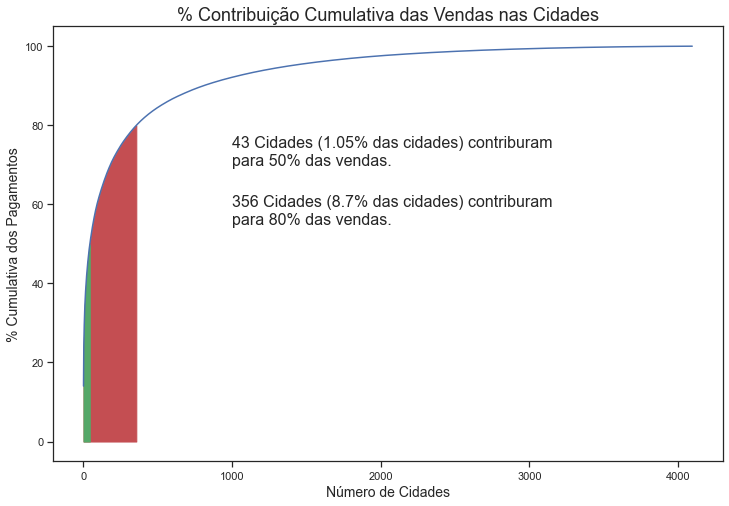

In [136]:
sns.set_style("ticks")

plt.figure(figsize=(12, 8))

ax = sns.lineplot(x=range(1,len(topRevenueByCity)+1), y="% Cumulativa dos Pagamentos", data=topRevenueByCity)
ax.set_xlabel("Número de Cidades", fontsize = 14)
ax.set_ylabel("% Cumulativa dos Pagamentos", fontsize = 14)
ax.set_title("% Contribuição Cumulativa das Vendas nas Cidades" , fontsize = 18)

a = np.arange(1,len(topRevenueByCity)+1)
b = topRevenueByCity["% Cumulativa dos Pagamentos"]

plt.fill_between(a, b, 0,
                 where = (a >= 0) & (a <= 356),
                 color = 'r')

plt.fill_between(a, b, 0,
                 where = (a >= 0) & (a <= 43),
                 color = 'g')

ax.text(1000, 70, """43 Cidades (1.05% das cidades) contriburam 
para 50% das vendas.""", fontsize = 16)

ax.text(1000, 55, """356 Cidades (8.7% das cidades) contriburam 
para 80% das vendas.""", fontsize = 16)

### 2.9.5 Total de Vendas por Estado em Porcentagem

In [137]:
salesRegiao.head()

,regiao,customer_id,percent,percent_number
3,Sudeste,68266,68.65%,68.65
4,Sul,14148,14.23%,14.23
1,Nordeste,9394,9.45%,9.45
0,CentroOeste,5782,5.81%,5.81
2,Norte,1851,1.86%,1.86


In [138]:
salesStatePercent = salesState.copy()

In [139]:
# Calculando porcentagem de cada estado em relação ao total de vendas
salesStatePercent['percent'] = (salesStatePercent['customer_id'] / salesStatePercent['customer_id'].sum()) * 100

In [140]:
salesStatePercent = salesStatePercent.sort_values(ascending = False, by = 'customer_id')

Analisando abaixo é perceptivel que o estado de São Paulo possui o maior numero de vendas disparado, com 40% das vendas, seguido do Rio de Janeiro e Minas Gerais com aproximadamente 13% das vendas.

In [141]:
# Plot

# Definição dos dados no plot
plot_data = [go.Bar(x = salesStatePercent['customer_state'], 
                    y = salesStatePercent['percent'])]

# Layout
plot_layout = go.Layout(xaxis = {"type": "category"}, 
                        title = 'Total de Vendas por Estado em Porcentagem')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)
pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'total_vendas_estado_porcentagem', auto_open = False)

### 2.9.6 % Contribuição Cumulativa das Vendas nos Estados

In [142]:
topRevenueByState = dtAll.groupby("customer_state")["payment_value"].sum().reset_index().sort_values("payment_value", ascending=False)
topRevenueByState["% of Total Payments"] = (topRevenueByState["payment_value"] / topRevenueByState["payment_value"].sum()) * 100
topRevenueByState["% Cumulativa dos Pagamentos"] = topRevenueByState["% of Total Payments"].cumsum() 

In [143]:
topRevenueByState.head()

,customer_state,payment_value,% of Total Payments,% Cumulativa dos Pagamentos
25,SP,7553411.48,37.470942,37.470942
18,RJ,2747860.23,13.631577,51.102519
10,MG,2310633.09,11.462582,62.565101
22,RS,1135485.31,5.632912,68.198013
17,PR,1058906.29,5.253019,73.451032


Text(12, 55, '7 Estados (25.93% das Estados) contriburam \npara 81% das vendas.')

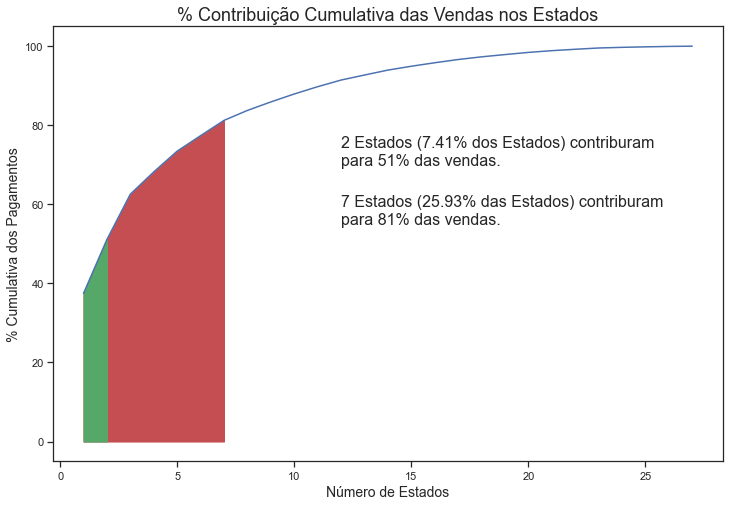

In [144]:
sns.set_style("ticks")

plt.figure(figsize=(12, 8))

ax = sns.lineplot(x=range(1,len(topRevenueByState)+1), y="% Cumulativa dos Pagamentos", data=topRevenueByState)
ax.set_xlabel("Número de Estados", fontsize = 14)
ax.set_ylabel("% Cumulativa dos Pagamentos", fontsize = 14)
ax.set_title("% Contribuição Cumulativa das Vendas nos Estados" , fontsize = 18)

a = np.arange(1,len(topRevenueByState)+1)
b = topRevenueByState["% Cumulativa dos Pagamentos"]

plt.fill_between(a, b, 0,
                 where = (a >= 0) & (a <= 7),
                 color = 'r')

plt.fill_between(a, b, 0,
                 where = (a >= 0) & (a <= 2),
                 color = 'g')

ax.text(12, 70, """2 Estados (7.41% dos Estados) contriburam 
para 51% das vendas.""", fontsize = 16)

ax.text(12, 55, """7 Estados (25.93% das Estados) contriburam 
para 81% das vendas.""", fontsize = 16)

## 2.10 Existe diferença significativa de numero de clientes por região?

### 2.10.1 Total de Clientes por Estado

In [145]:
customerState = dtCustomers[['customer_unique_id', 'customer_state']].drop_duplicates().copy()

In [146]:
customerState = customerState.groupby('customer_state')['customer_unique_id'].count()

In [147]:
customerState = customerState.sort_values(ascending = False).reset_index()

In [148]:
customerState['percent'] = customerState['customer_unique_id'].apply(lambda x: str( round(x / sum(customerState['customer_unique_id']) * 100, 2) ) + '%')

In [149]:
customerState.head()

,customer_state,customer_unique_id,percent
0,SP,40302,41.92%
1,RJ,12384,12.88%
2,MG,11259,11.71%
3,RS,5277,5.49%
4,PR,4882,5.08%


In [150]:
# Plot

# Definição dos dados no plot
plot_data = [go.Bar(x = customerState['customer_state'], 
                    y = customerState['customer_unique_id'],
                    text = customerState['percent'], textposition = 'outside')]

# Layout
plot_layout = go.Layout(xaxis = {"type": "category", 'title': 'Estados'},
                        yaxis = {'title': 'Vendas'},
                        title = 'Total de Clientes por Estado')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)
pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'total_clientes_estado', auto_open = False)

## 2.11 Quais produtos e vendas possuem maior numero de vendas?

Foi identificado que não é fornecido o nome do produto vendido, somente a categoria.

### 2.11.1 Top 10 Categorias Mais Vendidas

In [151]:
dtOrderItems.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


In [152]:
dtProducts.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [153]:
# Realizando o merge entre as duas tabelas
dtOrderProducts = pd.merge(dtOrderItems, dtProducts, on = 'product_id')

In [154]:
dtOrderProducts.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.9,13.29,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
1,130898c0987d1801452a8ed92a670612,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-07-05 02:44:11,55.9,17.96,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
2,532ed5e14e24ae1f0d735b91524b98b9,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2018-05-23 10:56:25,64.9,18.33,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
3,6f8c31653edb8c83e1a739408b5ff750,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-08-07 18:55:08,58.9,16.17,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
4,7d19f4ef4d04461989632411b7e588b9,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-08-16 22:05:11,58.9,13.29,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0


In [155]:
# Contando o numero de orders (não unicos) e relacionando a categoria
categoryProducts = dtOrderProducts.groupby('product_category_name')['order_id'].count().sort_values(ascending = False)

Analisando o grafico abaixo é perceptivel a disparidade entre as catogiras mais vendidas. Contudo algumas categorias com maiores numeros de vendas aparentam possuir relação entre as mesmas. Como por exemplo 'cama_mesa_banho' e 'beleza_saude'. Também 'moveis_decoracao' e 'utilidades_domesticas'.

In [156]:
categoryProductsTop10 = categoryProducts.head(10).sort_values(ascending = False).reset_index()

In [157]:
categoryProducts = categoryProducts.reset_index()

In [158]:
categoryProductsTop10['percent'] = categoryProductsTop10['order_id'].apply(lambda x: str( round(x / sum(categoryProducts['order_id']) * 100, 2) ) + '%')

In [159]:
categoryProductsTop10 = categoryProductsTop10.sort_values(ascending = True, by = 'order_id')

In [160]:
# Plot

# Definição dos dados no plot
plot_data = [go.Bar(y = categoryProductsTop10['product_category_name'], 
                    x = categoryProductsTop10['order_id'], orientation = 'h',
                    text = categoryProductsTop10['percent'], textposition = 'outside')]

# Layout
plot_layout = go.Layout(yaxis = {"type": "category", 'title': 'Categorias'},
                        xaxis = {'title': 'Vendas'},
                        title = 'Top 10 Categorias Mais Vendidas')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)
pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'top_10_categorias_vendidas', auto_open = False)

### 2.11.2 % Contribuição Cumulativa das Vendas nas Categorias

In [161]:
topRevenueByCategory = dtAll.groupby("product_category_name")["payment_value"].sum().reset_index().sort_values("payment_value", ascending=False)
topRevenueByCategory["% of Total Payments"] = (topRevenueByCategory["payment_value"] / topRevenueByCategory["payment_value"].sum()) * 100
topRevenueByCategory["% Cumulativa dos Pagamentos"] = topRevenueByCategory["% of Total Payments"].cumsum() 

Text(25, 55, '17 categorias (23.94% das categorias) contriburam \npara 81% das vendas.')

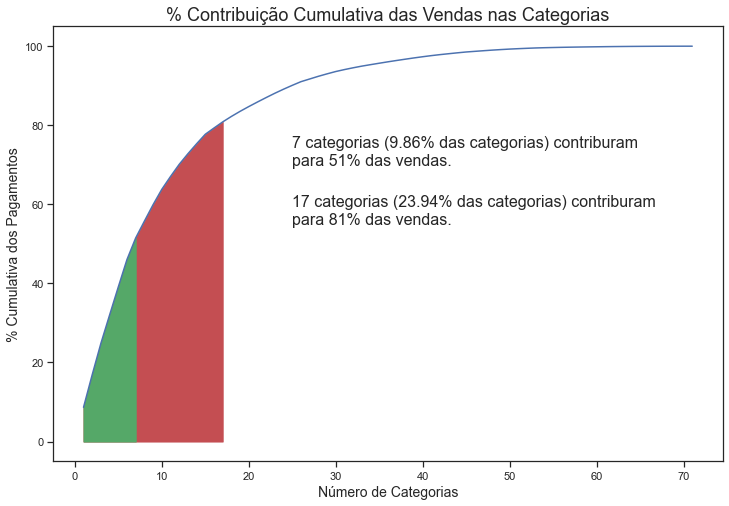

In [162]:
sns.set_style("ticks")

plt.figure(figsize=(12, 8))

ax = sns.lineplot(x=range(1,len(topRevenueByCategory)+1), y="% Cumulativa dos Pagamentos", data=topRevenueByCategory)
ax.set_xlabel("Número de Categorias", fontsize = 14)
ax.set_ylabel("% Cumulativa dos Pagamentos", fontsize = 14)
ax.set_title("% Contribuição Cumulativa das Vendas nas Categorias" , fontsize = 18)

a = np.arange(1,len(topRevenueByCategory)+1)
b = topRevenueByCategory["% Cumulativa dos Pagamentos"]

plt.fill_between(a, b, 0,
                 where = (a >= 0) & (a <= 17),
                 color = 'r')

plt.fill_between(a, b, 0,
                 where = (a >= 0) & (a <= 7),
                 color = 'g')

ax.text(25, 70, """7 categorias (9.86% das categorias) contriburam 
para 51% das vendas.""", fontsize = 16)

ax.text(25, 55, """17 categorias (23.94% das categorias) contriburam 
para 81% das vendas.""", fontsize = 16)

## 2.12 As notas de review do produto possuem impacto no número de vendas?

### 2.12.1 Vendas por Score (Score Médio por Produto)

In [163]:
dtOrderItems.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


In [164]:
dtOrderReviews.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53


In [165]:
reviewsOrders = pd.merge(dtOrderItems, dtOrderReviews, on = 'order_id')

In [166]:
reviewsOrders = reviewsOrders[['order_id', 'product_id', 'review_score']]

In [167]:
reviewsOrders = reviewsOrders.dropna()

In [168]:
reviewsOrders.head()

,order_id,product_id,review_score
0,00010242fe8c5a6d1ba2dd792cb16214,4244733e06e7ecb4970a6e2683c13e61,5
1,00018f77f2f0320c557190d7a144bdd3,e5f2d52b802189ee658865ca93d83a8f,4
2,000229ec398224ef6ca0657da4fc703e,c777355d18b72b67abbeef9df44fd0fd,5
3,00024acbcdf0a6daa1e931b038114c75,7634da152a4610f1595efa32f14722fc,4
4,00042b26cf59d7ce69dfabb4e55b4fd9,ac6c3623068f30de03045865e4e10089,5


In [169]:
pedidosProduto = reviewsOrders.groupby('product_id')['order_id'].count().sort_values(ascending = False)

In [170]:
pedidosProduto.head()

product_id
aca2eb7d00ea1a7b8ebd4e68314663af    527
99a4788cb24856965c36a24e339b6058    491
422879e10f46682990de24d770e7f83d    487
389d119b48cf3043d311335e499d9c6b    392
368c6c730842d78016ad823897a372db    391
Name: order_id, dtype: int64

In [171]:
scoreProduto = reviewsOrders.groupby('product_id')['review_score'].mean().sort_values(ascending = False)

In [172]:
scoreProduto.head()

product_id
00066f42aeeb9f3007548bb9d3f33c38    5.0
86743ff92eee3d16b7df59cddd583b8c    5.0
868ceb027ab706a4dee42e2220006b85    5.0
868969d3a93aeeab7bfcd4fc3d3d65de    5.0
868766ed2172644fdd977d6bd395a107    5.0
Name: review_score, dtype: float64

In [173]:
scoreOrders = scoreProduto.copy()

In [174]:
scoreOrders = scoreOrders.to_frame()

In [175]:
scoreOrders = pd.merge(scoreProduto, pedidosProduto, on = 'product_id')

In [176]:
scoreOrders.head()

,review_score,order_id
product_id,,
00066f42aeeb9f3007548bb9d3f33c38,5.0,1
86743ff92eee3d16b7df59cddd583b8c,5.0,1
868ceb027ab706a4dee42e2220006b85,5.0,1
868969d3a93aeeab7bfcd4fc3d3d65de,5.0,1
868766ed2172644fdd977d6bd395a107,5.0,1


In [177]:
scoreOrders.columns = ['score_medio', 'numero_pedidos']

In [178]:
scoreOrders.head()

,score_medio,numero_pedidos
product_id,,
00066f42aeeb9f3007548bb9d3f33c38,5.0,1
86743ff92eee3d16b7df59cddd583b8c,5.0,1
868ceb027ab706a4dee42e2220006b85,5.0,1
868969d3a93aeeab7bfcd4fc3d3d65de,5.0,1
868766ed2172644fdd977d6bd395a107,5.0,1


In [179]:
scoreOrders['score_medio'] = round(scoreOrders['score_medio'])

In [180]:
scoreOrders.sort_values(ascending = False, by = 'numero_pedidos').head()

,score_medio,numero_pedidos
product_id,,
aca2eb7d00ea1a7b8ebd4e68314663af,4.0,527
99a4788cb24856965c36a24e339b6058,4.0,491
422879e10f46682990de24d770e7f83d,4.0,487
389d119b48cf3043d311335e499d9c6b,4.0,392
368c6c730842d78016ad823897a372db,4.0,391


In [181]:
meanScoreOrders = scoreOrders.groupby('score_medio')['numero_pedidos'].sum().reset_index()

In [182]:
meanScoreOrders['percent'] = meanScoreOrders['numero_pedidos'].apply(lambda x: str( round(x / sum(meanScoreOrders['numero_pedidos']) * 100, 2) ) + '%')

In [183]:
meanScoreOrders

,score_medio,numero_pedidos,percent
0,1.0,3798,3.35%
1,2.0,3723,3.29%
2,3.0,12364,10.91%
3,4.0,62359,55.03%
4,5.0,31078,27.42%


In [184]:
# Plot

# Definição dos dados no plot
plot_data = [go.Bar(x = meanScoreOrders['score_medio'], 
                    y = meanScoreOrders['numero_pedidos'],
                    text = meanScoreOrders['percent'], textposition = 'outside')]

# Layout
plot_layout = go.Layout(xaxis = {"type": "category", 'title': 'Score'},
                        yaxis = {'title': 'Vendas'},
                        title = 'Vendas por Score (Score Médio por Produto)')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)
pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'vendas_por_score', auto_open = False)

## 3. WordCloud de Reviews

In [185]:
dtOrderReviews.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53


In [186]:
dtOrderReviewsTemp = dtOrderReviews['review_comment_message']

In [187]:
dtOrderReviewsTemp = dtOrderReviewsTemp.dropna()

In [188]:
dtOrderReviewsTemp.head()

3                 Recebi bem antes do prazo estipulado.
4     Parabéns lojas lannister adorei comprar pela I...
9     aparelho eficiente. no site a marca do aparelh...
12      Mas um pouco ,travando...pelo valor ta Boa.\r\n
15    Vendedor confiável, produto ok e entrega antes...
Name: review_comment_message, dtype: object

In [189]:
def limpar_texto(text):
    # Convertendo para str
    text = str(text)
    
    # Remover caracteres non-ascii
    text = ''.join(caracter for caracter in text if ord(caracter) < 128)
    
    # Convertendo para lower case
    text = text.lower()
    
    # Removendo pontuação por expressão regular
    regex = re.compile('[' + re.escape(string.punctuation) + '\\r\\t\\n]')
    text = regex.sub(' ', str(text))
    
    # Carregando stopwords em português
    portuguese_stops = set(stopwords.words('portuguese'))
    
    # Removendo stopwords em português
    # Mantendo somente palavras que não são consideradas stopwords
    text = ' '.join(palavra for palavra in text.split() if palavra not in portuguese_stops)
    
    # Criando a estrutura baseada em uma wordnet para lemmatization
    wordnet_lemmatizer = WordNetLemmatizer()    
    # Aplicando Lemmatization
    text = ' '.join(wordnet_lemmatizer.lemmatize(palavra) for palavra in text.split())
    
    return text

In [190]:
dtOrderReviewsTemp = dtOrderReviewsTemp.to_frame()

In [191]:
dtOrderReviewsTemp

,review_comment_message
3,Recebi bem antes do prazo estipulado.
4,Parabéns lojas lannister adorei comprar pela I...
9,aparelho eficiente. no site a marca do aparelh...
12,"Mas um pouco ,travando...pelo valor ta Boa.\r\n"
15,"Vendedor confiável, produto ok e entrega antes..."
...,...
99983,Entregou dentro do prazo. O produto chegou em ...
99990,"O produto não foi enviado com NF, não existe v..."
99996,"Excelente mochila, entrega super rápida. Super..."
99998,Solicitei a compra de uma capa de retrovisor c...


In [192]:
print(dtOrderReviewsTemp['review_comment_message'][9])

aparelho eficiente. no site a marca do aparelho esta impresso como 3desinfector e ao chegar esta com outro nome...atualizar com a marca correta uma vez que é o mesmo aparelho


In [193]:
dtOrderReviewsTratado = dtOrderReviewsTemp.copy()

In [194]:
%%time
print('Tratanto texto...')
dtOrderReviewsTratado['review_comment_message'] = dtOrderReviews['review_comment_message'].map(limpar_texto)
print('Texto tratado')

Tratanto texto...
Texto tratado
CPU times: total: 21.4 s
Wall time: 21.4 s


In [195]:
print(dtOrderReviewsTratado['review_comment_message'][9])

aparelho eficiente site marca aparelho impresso 3desinfector chegar outro nome atualizar marca correta vez aparelho


In [196]:
dtOrderReviewsTratado.head()

,review_comment_message
3,recebi bem ante prazo estipulado
4,parabns lojas lannister adorei comprar interne...
9,aparelho eficiente site marca aparelho impress...
12,pouco travando valor ta boa
15,vendedor confivel produto ok entrega ante prazo


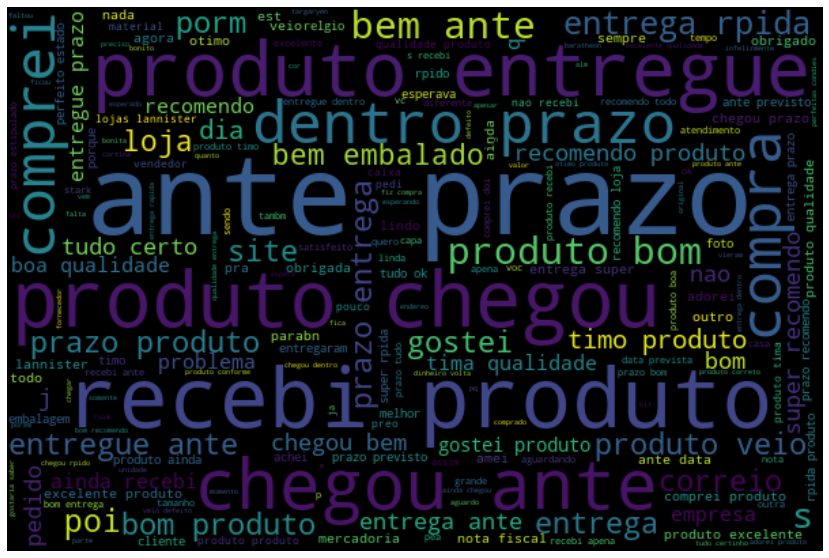

In [197]:
wordcloud = WordCloud(width = 600, height = 400).generate_from_text(\
                                                                ' '.join(dtOrderReviewsTratado['review_comment_message']))
plt.figure(figsize = (15, 10))
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.savefig('export/wordcloud.png')
plt.show()

## 4. A localização impacta no tempo de entrega?

Por motivos de tempo para desenvolvimento, foi optado por realizar uma estimativa em mapa de calor de quantas vendas são realizas por micro região.

In [198]:
dtGeolocation.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,regiao
0,01037,-23.545621,-46.639292,sao paulo,SP,Sudeste
1,01046,-23.546081,-46.644820,sao paulo,SP,Sudeste
2,01046,-23.546129,-46.642951,sao paulo,SP,Sudeste
3,01041,-23.544392,-46.639499,sao paulo,SP,Sudeste
4,01035,-23.541578,-46.641607,sao paulo,SP,Sudeste


In [199]:
latIng = dtGeolocation[['geolocation_lat', 'geolocation_lng']]

In [200]:
latIng.head()

,geolocation_lat,geolocation_lng
0,-23.545621,-46.639292
1,-23.546081,-46.644820
2,-23.546129,-46.642951
3,-23.544392,-46.639499
4,-23.541578,-46.641607


In [201]:
#geolocator = Nominatim(user_agent = 'Brazilian E-commerce Olist')

In [202]:
mapa = folium.Map([-10, -50], tiles = 'stamentoner', zoom_start = 5)

In [203]:
HeatMap(latIng, min_opacity = 0.2, radis = 2, blur = 10).add_to(mapa)

In [204]:
mapa.save('mapas/heatMap_ceps.html')

In [205]:
mapa = folium.Map([-10, -50], zoom_start = 5)

In [206]:
FastMarkerCluster(data = latIng).add_to(mapa)

In [207]:
mapa.save('mapas/mapa_clusters_ceps.html')

# 5. O tempo de entrega impacta no review do produto?

Analise de pedidos em atraso e tempo de atraso.

In [208]:
# Juntando tabela de pedidos com itens
deliveryAnalysis = dtOrderItems.merge(dtOrders, how = 'left', on = 'order_id').merge(dtOrderReviews, how = 'left', on = 'order_id')

In [209]:
# Corrgindo tipos de colunas de data
deliveryAnalysis = deliveryAnalysis.assign(
    order_delivered_customer_date = pd.to_datetime(deliveryAnalysis["order_delivered_customer_date"]).dt.date,
    order_delivered_carrier_date = pd.to_datetime(deliveryAnalysis["order_delivered_carrier_date"]).dt.date,
    order_estimated_delivery_date = pd.to_datetime(deliveryAnalysis["order_estimated_delivery_date"]).dt.date,
    shipping_limit_date = pd.to_datetime(deliveryAnalysis["shipping_limit_date"]).dt.date,
    order_purchase_timestamp = pd.to_datetime(deliveryAnalysis['order_purchase_timestamp']).dt.date)

In [210]:
# Calculando tempo de entrega e estimado vs entregue
deliveryAnalysis = deliveryAnalysis.assign(delivered_days = (deliveryAnalysis['order_delivered_customer_date'] - deliveryAnalysis['order_purchase_timestamp']).dt.days,
                                 estimated_days_vs_delivery = (deliveryAnalysis['order_estimated_delivery_date'] - deliveryAnalysis['order_delivered_customer_date']).dt.days)

In [211]:
# Identificando status do pedido
deliveryAnalysis['delivery_status'] = np.where(deliveryAnalysis['estimated_days_vs_delivery'] < 0, 'Atrasado', 'No prazo')

In [212]:
conditions = [(deliveryAnalysis['estimated_days_vs_delivery'] < -30),
              (deliveryAnalysis['estimated_days_vs_delivery'] < -15),
              (deliveryAnalysis['estimated_days_vs_delivery'] < -10),
              (deliveryAnalysis['estimated_days_vs_delivery'] <= -5),
              (deliveryAnalysis['estimated_days_vs_delivery'] < 0)]
choices = ['Mais de 30 dias', 'Entre 15 e 30 dias', 'Entre 10 e 15 dias', 'Entre 5 e 10 dias','Menos de 5 dias']
deliveryAnalysis['delivery_status_detail'] = np.select(conditions, choices, default = 'No prazo')

In [213]:
deliveryAnalysis = deliveryAnalysis.drop_duplicates(keep = False, inplace = False)

In [214]:
deliveryAnalysisFiltered = deliveryAnalysis[['order_id','delivery_status']]
dlv = deliveryAnalysisFiltered.pivot_table(values = 'order_id',index = 'delivery_status', aggfunc = 'nunique')

In [215]:
# Filtrando status por atrasado para ver quanto tempo de atraso
late_deliver_df = deliveryAnalysis[deliveryAnalysis['delivery_status'] == 'Atrasado']
delayedDaysStatus = late_deliver_df.pivot_table(values = 'order_id', index = 'delivery_status_detail', aggfunc = 'nunique')
delayedDaysStatus = delayedDaysStatus.reindex(choices)

In [216]:
# Definição dos dados no plot
values = dlv.values

plot_data = [go.Pie(labels = dlv.index, values = dlv['order_id'], name = 'Status')]

# Layout
plot_layout = go.Layout(title={'text': '% de pedidos Etregues no Período', 'y':0.9, 'x':0.5, 'xanchor': 'center', 'yanchor': 'top'})

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)

fig.update_layout(legend_title_text='Status', legend=dict(
    yanchor="top",
    y = 0.80,
    xanchor="right",
    x = 0.7
))

pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'pedidos_atrasados_vs_no_prazo', auto_open = False)

In [217]:
# Definição dos dados no plot
plot_data = [go.Pie(labels = delayedDaysStatus.index, values = delayedDaysStatus['order_id'], name = 'NDiasAtraso', sort = False)]

# Layout
plot_layout = go.Layout(title={'text': '% Por Categoria de Dias de Atraso', 'y':0.9, 'x':0.5, 'xanchor': 'center', 'yanchor': 'top'})

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)

fig.update_layout(legend_title_text='Dias atrasado', legend=dict(
    yanchor="top",
    y = 0.80,
    xanchor="right",
    x = 0.725
))


pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'categoria_dias_de_atraso', auto_open = False)

In [218]:
deliveryStatusByScore = pd.DataFrame()

In [219]:
for i in range(5):
    score = i + 1
    
    noPrazo = deliveryAnalysis.query("review_score == {0} and delivery_status == 'No prazo'".format(score)).count()[0]
    atrasado = deliveryAnalysis.query("review_score == {0} and delivery_status == 'Atrasado'".format(score)).count()[0]
    
    deliveryStatusByScore = deliveryStatusByScore.append(pd.DataFrame({'Score': [score], 'No prazo': [noPrazo], 'Atrasado': [atrasado]}))

In [220]:
# Definição dos dados no plot
plot_data = [go.Pie(labels = deliveryStatusByScore.Score, values = deliveryStatusByScore.Atrasado, name = 'NDiasAtraso', sort = False)]

# Layout
plot_layout = go.Layout(title={'text': '% de Pedidos Atrasados por Score', 'y':0.9, 'x':0.5, 'xanchor': 'center', 'yanchor': 'top'})

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)

fig.update_layout(legend_title_text='Score', legend=dict(
    yanchor="top",
    y = 0.80,
    xanchor="right",
    x = 0.7
))

pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'pedidos_atrasados_por_score', auto_open = False)

In [221]:
deliveryAnalysisDelayed = deliveryAnalysis[deliveryAnalysis['estimated_days_vs_delivery'] < 0]

In [222]:
deliveryAnalysisDelayed = deliveryAnalysisDelayed[deliveryAnalysisDelayed['estimated_days_vs_delivery'] > -50]

In [223]:
fig = go.Figure()

fig.add_trace(go.Box(y= deliveryAnalysisDelayed[deliveryAnalysisDelayed['review_score'] == 1]['estimated_days_vs_delivery'], name = '1'))
fig.add_trace(go.Box(y= deliveryAnalysisDelayed[deliveryAnalysisDelayed['review_score'] == 2]['estimated_days_vs_delivery'], name = '2'))
fig.add_trace(go.Box(y= deliveryAnalysisDelayed[deliveryAnalysisDelayed['review_score'] == 3]['estimated_days_vs_delivery'], name = '3'))
fig.add_trace(go.Box(y= deliveryAnalysisDelayed[deliveryAnalysisDelayed['review_score'] == 4]['estimated_days_vs_delivery'], name = '4'))
fig.add_trace(go.Box(y= deliveryAnalysisDelayed[deliveryAnalysisDelayed['review_score'] == 5]['estimated_days_vs_delivery'], name = '5'))

fig.update_traces(boxpoints = 'outliers', jitter = 0)

fig.update_layout(legend_title_text = 'Score', title = 'Dias de Atraso por Score')

fig.show()

## 5.1 Diferença de Entrega entre Previsto e Real em Dias

In [224]:
dtOrders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [225]:
reviewsOrders.head()

,order_id,product_id,review_score
0,00010242fe8c5a6d1ba2dd792cb16214,4244733e06e7ecb4970a6e2683c13e61,5
1,00018f77f2f0320c557190d7a144bdd3,e5f2d52b802189ee658865ca93d83a8f,4
2,000229ec398224ef6ca0657da4fc703e,c777355d18b72b67abbeef9df44fd0fd,5
3,00024acbcdf0a6daa1e931b038114c75,7634da152a4610f1595efa32f14722fc,4
4,00042b26cf59d7ce69dfabb4e55b4fd9,ac6c3623068f30de03045865e4e10089,5


In [226]:
reviewOrdersTime = pd.merge(reviewsOrders, dtOrders, on = 'order_id')

In [227]:
reviewOrdersTime = reviewOrdersTime[reviewOrdersTime['order_status'] == 'delivered']

In [228]:
reviewOrdersTime = reviewOrdersTime[['order_id', 'product_id', 'review_score', 'order_delivered_carrier_date',\
                                     'order_delivered_customer_date', 'order_estimated_delivery_date']]

In [229]:
reviewOrdersTime.head()

,order_id,product_id,review_score,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,00010242fe8c5a6d1ba2dd792cb16214,4244733e06e7ecb4970a6e2683c13e61,5,2017-09-19 18:34:16,2017-09-20 23:43:48,2017-09-29 00:00:00
1,00018f77f2f0320c557190d7a144bdd3,e5f2d52b802189ee658865ca93d83a8f,4,2017-05-04 14:35:00,2017-05-12 16:04:24,2017-05-15 00:00:00
2,000229ec398224ef6ca0657da4fc703e,c777355d18b72b67abbeef9df44fd0fd,5,2018-01-16 12:36:48,2018-01-22 13:19:16,2018-02-05 00:00:00
3,00024acbcdf0a6daa1e931b038114c75,7634da152a4610f1595efa32f14722fc,4,2018-08-10 13:28:00,2018-08-14 13:32:39,2018-08-20 00:00:00
4,00042b26cf59d7ce69dfabb4e55b4fd9,ac6c3623068f30de03045865e4e10089,5,2017-02-16 09:46:09,2017-03-01 16:42:31,2017-03-17 00:00:00


In [230]:
# Mantendo somente Ano, Mes e Dia
reviewOrdersTime['order_delivered_carrier_date'] = \
    pd.to_datetime(reviewOrdersTime['order_delivered_carrier_date'], format = '%Y-%m-%d %H:%M:%S').dt.to_period('d')

In [231]:
# Mantendo somente Ano, Mes e Dia
reviewOrdersTime['order_delivered_customer_date'] = \
    pd.to_datetime(reviewOrdersTime['order_delivered_customer_date'], format = '%Y-%m-%d %H:%M:%S').dt.to_period('d')

In [232]:
# Mantendo somente Ano, Mes e Dia
reviewOrdersTime['order_estimated_delivery_date'] = \
    pd.to_datetime(reviewOrdersTime['order_estimated_delivery_date'], format = '%Y-%m-%d %H:%M:%S').dt.to_period('d')

In [233]:
reviewOrdersTime.head()

,order_id,product_id,review_score,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,00010242fe8c5a6d1ba2dd792cb16214,4244733e06e7ecb4970a6e2683c13e61,5,2017-09-19,2017-09-20,2017-09-29
1,00018f77f2f0320c557190d7a144bdd3,e5f2d52b802189ee658865ca93d83a8f,4,2017-05-04,2017-05-12,2017-05-15
2,000229ec398224ef6ca0657da4fc703e,c777355d18b72b67abbeef9df44fd0fd,5,2018-01-16,2018-01-22,2018-02-05
3,00024acbcdf0a6daa1e931b038114c75,7634da152a4610f1595efa32f14722fc,4,2018-08-10,2018-08-14,2018-08-20
4,00042b26cf59d7ce69dfabb4e55b4fd9,ac6c3623068f30de03045865e4e10089,5,2017-02-16,2017-03-01,2017-03-17


In [234]:
reviewOrdersTime.dtypes

order_id                            object
product_id                          object
review_score                         int64
order_delivered_carrier_date     period[D]
order_delivered_customer_date    period[D]
order_estimated_delivery_date    period[D]
dtype: object

In [235]:
print(reviewOrdersTime.isna().sum())

order_id                         0
product_id                       0
review_score                     0
order_delivered_carrier_date     2
order_delivered_customer_date    8
order_estimated_delivery_date    0
dtype: int64


In [236]:
reviewOrdersTime = reviewOrdersTime.dropna()

In [237]:
print(reviewOrdersTime.shape)

(110839, 6)


In [238]:
reviewOrdersTime['diff_delivery_and_estimate'] = reviewOrdersTime['order_estimated_delivery_date'] -\
                                           reviewOrdersTime['order_delivered_customer_date']

In [239]:
reviewOrdersTime['diff_delivery_and_estimate'] = \
                reviewOrdersTime['diff_delivery_and_estimate'].apply(lambda x: re.sub("[^0-9]", "", str(x)))

In [240]:
reviewOrdersTime['diff_delivery_and_estimate'] = pd.to_numeric(reviewOrdersTime['diff_delivery_and_estimate'])

In [241]:
reviewOrdersTime.head()

,order_id,product_id,review_score,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,diff_delivery_and_estimate
0,00010242fe8c5a6d1ba2dd792cb16214,4244733e06e7ecb4970a6e2683c13e61,5,2017-09-19,2017-09-20,2017-09-29,9.0
1,00018f77f2f0320c557190d7a144bdd3,e5f2d52b802189ee658865ca93d83a8f,4,2017-05-04,2017-05-12,2017-05-15,3.0
2,000229ec398224ef6ca0657da4fc703e,c777355d18b72b67abbeef9df44fd0fd,5,2018-01-16,2018-01-22,2018-02-05,14.0
3,00024acbcdf0a6daa1e931b038114c75,7634da152a4610f1595efa32f14722fc,4,2018-08-10,2018-08-14,2018-08-20,6.0
4,00042b26cf59d7ce69dfabb4e55b4fd9,ac6c3623068f30de03045865e4e10089,5,2017-02-16,2017-03-01,2017-03-17,16.0


In [242]:
reviewOrdersTime.dtypes

order_id                            object
product_id                          object
review_score                         int64
order_delivered_carrier_date     period[D]
order_delivered_customer_date    period[D]
order_estimated_delivery_date    period[D]
diff_delivery_and_estimate         float64
dtype: object

Não possuem atrasos.

In [243]:
reviewOrdersTime[reviewOrdersTime['diff_delivery_and_estimate'] < 0].head()

,order_id,product_id,review_score,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,diff_delivery_and_estimate


In [244]:
reviewOrdersTime[reviewOrdersTime['diff_delivery_and_estimate'] <= 0].head()

,order_id,product_id,review_score,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,diff_delivery_and_estimate
8,0005a1a1728c9d785b8e2b08b904576c,310ae3c140ff94b03219ad0adc3c778f,1,2018-03-28,2018-03-29,2018-03-29,0.0
11,00063b381e2406b52ad429470734ebd5,f177554ea93259a5b282f24e33f65ab6,5,2018-07-30,2018-08-07,2018-08-07,0.0
101,00378c6c981f234634c0b9d6128df6dd,38fa750a3a3b3204f169c86a3284d387,4,2018-02-05,2018-02-26,2018-02-26,0.0
231,0097f0545a302aafa32782f1734ff71c,b6397895a17ce86decd60b898b459796,1,2018-03-06,2018-03-21,2018-03-21,0.0
232,0097f0545a302aafa32782f1734ff71c,636598095d69a5718e67d2c9a3c7dde6,1,2018-03-06,2018-03-21,2018-03-21,0.0


In [245]:
COLOR_5S = '#0571b0'
COLOR_1S = '#ca0020'
REVIEWS_PALETTE = sns.color_palette((COLOR_1S, '#d57b6f', '#c6c6c6', '#7f9abc', COLOR_5S))

In [246]:
resize_plot = lambda: plt.gcf().set_size_inches(12, 5)

In [247]:
reviewOrdersTime['order_delivered_customer_date'] = reviewOrdersTime['order_delivered_customer_date'].astype('str')

Visto que não possuem atrasos para os pedidos, é notado que não possui um padrão claro wem relação ao tempo de entrega versus o review.

In [248]:
reviewOrdersTime.head()

,order_id,product_id,review_score,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,diff_delivery_and_estimate
0,00010242fe8c5a6d1ba2dd792cb16214,4244733e06e7ecb4970a6e2683c13e61,5,2017-09-19,2017-09-20,2017-09-29,9.0
1,00018f77f2f0320c557190d7a144bdd3,e5f2d52b802189ee658865ca93d83a8f,4,2017-05-04,2017-05-12,2017-05-15,3.0
2,000229ec398224ef6ca0657da4fc703e,c777355d18b72b67abbeef9df44fd0fd,5,2018-01-16,2018-01-22,2018-02-05,14.0
3,00024acbcdf0a6daa1e931b038114c75,7634da152a4610f1595efa32f14722fc,4,2018-08-10,2018-08-14,2018-08-20,6.0
4,00042b26cf59d7ce69dfabb4e55b4fd9,ac6c3623068f30de03045865e4e10089,5,2017-02-16,2017-03-01,2017-03-17,16.0


In [249]:
fig = px.scatter(reviewOrdersTime, x="order_delivered_customer_date", y="diff_delivery_and_estimate", color = "review_score",
                 title="Diferença de Entrega entre Previsto e Real em Dias", labels = {'diff_delivery_and_estimate': 'Diferença de Dias entre Previsto e Real',
                                                                                                               'order_delivered_customer_date': 'Periodo', 'review_score': 'Score'})

fig.show()

# Upando no dash
#if upload_to_dash:
#    py.plot(fig, filename = 'diferenca_entrega_previst_real', auto_open = False)

C:\Users\herik\AppData\Local\Temp\ipykernel_63516\1907121668.py:9: MatplotlibDeprecationWarning:

Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.



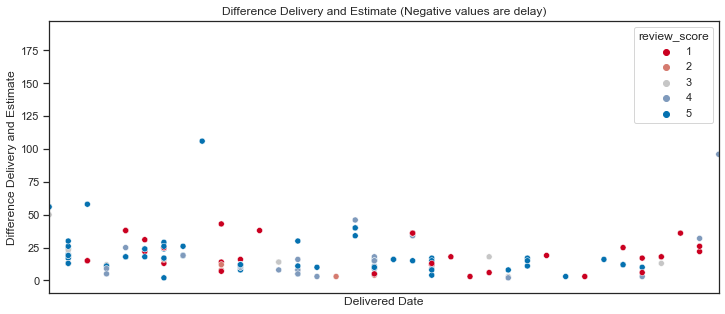

In [250]:
sns.scatterplot(x = 'order_delivered_customer_date', y = 'diff_delivery_and_estimate',
               hue = 'review_score',
               palette = REVIEWS_PALETTE,
               data = reviewOrdersTime)
plt.xlabel('Delivered Date')
plt.ylabel('Difference Delivery and Estimate')
plt.title('Difference Delivery and Estimate (Negative values are delay)')
plt.xlim(reviewOrdersTime['order_delivered_customer_date'].min(), reviewOrdersTime['order_delivered_customer_date'].max())
plt.xticks([])
resize_plot()

## 6. Quais categorias são mais consumidas por região?

Para melhor construção e interpretação do grafico iremos determinar que as regiões são iguais aos estados, e para resumirmos os dados iremos utilizar somente os 5 estados com maior representação nos dados conforme visto no indicador 2.2.5 . Também iremos resumir os dados em relação aos produtos, utilizando somente os top 3 ou 5 categorias de cada região.

### 6.1 Categorias Mais Vendidas por Estado

Estados com maior representatividade em vendas:
1. São Paulo
2. Rio de Janeiro
3. Minas Gerais
4. Rio Grande do Sul
5. Paraná
6. Santa Catarina

In [251]:
customerNotUniqueState = dtCustomers[['customer_id', 'customer_state']].drop_duplicates().copy()

In [252]:
customerNotUniqueState = pd.merge(customerNotUniqueState, dtOrders, on = 'customer_id')

In [253]:
customerNotUniqueState = customerNotUniqueState[['customer_id', 'customer_state', 'order_id']]

In [254]:
customerNotUniqueState = pd.merge(customerNotUniqueState, dtOrderProducts , on = 'order_id')

In [255]:
customerNotUniqueStateFiltered = customerNotUniqueState[['customer_id', 'customer_state', 'order_id', 'product_category_name']]

In [256]:
customerNotUniqueStateFiltered.head()

,customer_id,customer_state,order_id,product_category_name
0,06b8999e2fba1a1fbc88172c00ba8bc7,SP,00e7ee1b050b8499577073aeb2a297a1,moveis_escritorio
1,18955e83d337fd6b2def6b18a428ac77,SP,29150127e6685892b6eab3eec79f59c7,utilidades_domesticas
2,4e7b3e00288586ebd08712fdd0374a03,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,moveis_escritorio
3,b2b6027bc5c5109e529d4dc6358b12c3,SP,951670f92359f4fe4a63112aa7306eba,moveis_escritorio
4,4f2d8ab171c80ec8364f7c12e35b23ad,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,casa_conforto


In [257]:
customerNotUniqueStateFiltered[customerNotUniqueStateFiltered['customer_state'] == 'SP']['product_category_name'].\
    value_counts().head(5).reset_index()#.plot(kind = 'barh')

,index,product_category_name
0,cama_mesa_banho,5235
1,beleza_saude,4204
2,esporte_lazer,3667
3,moveis_decoracao,3531
4,utilidades_domesticas,3265


É perceptivel que no estado de São Paulo possui um numero muito maior de vendas em relação a 'Cama_mesa_banho' para os outros produtos. Essa diferença para a mesma categoria se torna maior no estado do RJ.

Já no estado do Paraná as vendas se apresentam maior em 'moveis_decoracao' e em Santa Catarina apesar de o equilibrio das vendas ser proximo, 'esporte_lazer' lidera as vendas. Porém, é perceptivel que as mesmas top categorias tendem a aparecer em todos os estados, porém com proporções diferentes.

In [258]:
customerNotUniqueStateFiltered.head()

,customer_id,customer_state,order_id,product_category_name
0,06b8999e2fba1a1fbc88172c00ba8bc7,SP,00e7ee1b050b8499577073aeb2a297a1,moveis_escritorio
1,18955e83d337fd6b2def6b18a428ac77,SP,29150127e6685892b6eab3eec79f59c7,utilidades_domesticas
2,4e7b3e00288586ebd08712fdd0374a03,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,moveis_escritorio
3,b2b6027bc5c5109e529d4dc6358b12c3,SP,951670f92359f4fe4a63112aa7306eba,moveis_escritorio
4,4f2d8ab171c80ec8364f7c12e35b23ad,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,casa_conforto


In [259]:
states = ['SP', 'RJ', 'MG', 'RS', 'PR', 'SC']
top_category = 5

col_nums = 2
row_nums = 3
row_ = 1
col_ = 1
maximumRange = 5500

fig = make_subplots(rows = row_nums, cols = col_nums, shared_yaxes = False, subplot_titles = states,
                   horizontal_spacing = 0.25)

for i, state in enumerate(states, 1):
    dtFiltrado = customerNotUniqueStateFiltered[customerNotUniqueStateFiltered['customer_state'] == states[i - 1]]['product_category_name'].\
    value_counts().head(top_category).sort_values(ascending = True).reset_index()
    
    fig.add_trace(go.Bar(x = dtFiltrado['product_category_name'],
                         y = dtFiltrado['index'], orientation = 'h'), row = row_, col = col_)
    fig.update_yaxes(showgrid = False, row = row_, col = col_, title = 'Categorias')
    fig.update_xaxes(showgrid = True, row = row_, col = col_, title = 'Vendas')
    fig.update_xaxes(range = [0, maximumRange])
    
    col_ += 1
    if col_ > col_nums:
        col_ = 1
        row_ += 1


fig.update_layout(showlegend = False, title_text = "Categorias Mais Vendidas por Estado", height = 700)
fig.show()

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'categorias_mais_vendidas_por_estado', auto_open = False)

Com o objetivo de visualizar os produtos mais vendidos de forma geral e ao mesmo tempo a sua divisão por estado. Foi proposto um gráfico onde foi coletado os estados com maior taxa de vendas, e filtrado as suas vendas pelos produtos que possuem mais vendas em um contexto geral no e-commerce. Assim sendo possível ver o comportamento dos produtos de maior saida em um contexto por estado.

### 6.2 Categorias Mais Vendidas nos Estados de Maior Demanda

In [260]:
states = ['SP', 'RJ', 'MG', 'RS', 'PR', 'SC']
top_category = 5

col_nums = 2
row_nums = 3
row_ = 1
col_ = 1
maximumRange = 5500

fig = make_subplots(rows = row_nums, cols = col_nums, shared_yaxes = False, subplot_titles = states,
                   horizontal_spacing = 0.25)

topGeneralProducts = customerNotUniqueStateFiltered['product_category_name'].value_counts().head(5).reset_index()['index'].tolist()

for i, state in enumerate(states, 1):
    dtFiltrado = customerNotUniqueStateFiltered[customerNotUniqueStateFiltered['customer_state'] == states[i - 1]]
    dtFiltrado = dtFiltrado[dtFiltrado['product_category_name'].isin(topGeneralProducts)]['product_category_name'].value_counts().head(5).reset_index().sort_values('index')
    
    fig.add_trace(go.Bar(x = dtFiltrado['product_category_name'],
                         y = dtFiltrado['index'], orientation = 'h'), row = row_, col = col_)
    fig.update_yaxes(showgrid = False, row = row_, col = col_, title = 'Categorias')
    fig.update_xaxes(showgrid = True, row = row_, col = col_, title = 'Vendas')
    fig.update_xaxes(range = [0, maximumRange])
    
    col_ += 1
    if col_ > col_nums:
        col_ = 1
        row_ += 1


fig.update_layout(showlegend = False, title_text = "Categorias Mais Vendidas nos Estados de Maior Demanda", height = 700)
fig.show()

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'categorias_mais_vendidas_nos_estados_de_maior_demanda', auto_open = False)

### 6.3 Categorias Mais Vendidas entre 2016 e 2018

In [261]:
dtFiltrado = pd.merge(dtOrdersAjustado, customerNotUniqueStateFiltered, on = 'order_id')

In [262]:
dtFiltrado = dtFiltrado[['order_purchase_timestamp', 'product_category_name']]

In [263]:
dtFiltrado2 = dtFiltrado.copy()

In [264]:
dtFiltrado2['order_purchase_timestamp'] = dtFiltrado2['order_purchase_timestamp'].dt.date

In [265]:
dtFiltrado2 = dtFiltrado2.sort_values('order_purchase_timestamp')

In [266]:
dtFiltrado2.head()

,order_purchase_timestamp,product_category_name
34053,2016-09-15,beleza_saude
34052,2016-09-15,beleza_saude
34051,2016-09-15,beleza_saude
108516,2016-10-03,esporte_lazer
103314,2016-10-03,relogios_presentes


In [267]:
dtFiltrado2 = dtFiltrado2.groupby(['order_purchase_timestamp','product_category_name']).agg(pedidos=('product_category_name', 'count'))

In [268]:
dtFiltrado2 = dtFiltrado2.reset_index()

In [269]:
dtFiltrado2['order_purchase_timestamp'] = pd.to_datetime(dtFiltrado2['order_purchase_timestamp'], format = '%Y-%m-%d')

In [270]:
# Remove outliers
dtFiltrado2 = dtFiltrado2[(dtFiltrado2['order_purchase_timestamp'] > "2017-01-01") & (dtFiltrado2['order_purchase_timestamp'] < "2018-08-07")]
dtFiltrado2 = dtFiltrado2[(dtFiltrado2['order_purchase_timestamp'] != "2017-11-24")]

In [271]:
dtFiltrado2.head()

,order_purchase_timestamp,product_category_name,pedidos
122,2017-01-05,automotivo,2
123,2017-01-05,bebes,2
124,2017-01-05,brinquedos,2
125,2017-01-05,fashion_bolsas_e_acessorios,9
126,2017-01-05,ferramentas_jardim,1


In [272]:
topGeneralProducts = customerNotUniqueStateFiltered['product_category_name'].value_counts().head(5).reset_index()['index'].tolist()

In [273]:
fig = go.Figure()

for i in topGeneralProducts:
    fig.add_trace(go.Scatter(x=dtFiltrado2[dtFiltrado2['product_category_name']== i]['order_purchase_timestamp'], y=dtFiltrado2[dtFiltrado2['product_category_name']== i]['pedidos'],\
                    mode = 'lines',\
                    name = i, connectgaps=True,\
                    line=dict(width=1.5, dash='dash')))
    
fig.update_layout(title_text = "Categorias Mais Vendidas entre 2016 e 2018")
fig.update_yaxes(title = 'Vendas')
fig.update_xaxes(title = 'Período')

fig.show()

## 7. Clientes Ativos por Mês

Clientes ativos são aqueles que fizeram pelo menos uma compra em cada mês.

In [274]:
dtCustomers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,regiao
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,Sudeste
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,Sudeste
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,Sudeste
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,Sudeste
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,Sudeste


In [275]:
dtOrders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [276]:
dtCustomersOrders = pd.merge(dtCustomers, dtOrders, on = 'customer_id')

In [277]:
# Mantendo somente Ano e Mes
dtCustomersOrders['order_purchase_timestamp'] =\
        pd.to_datetime(dtCustomersOrders['order_purchase_timestamp'], format = '%Y-%m-%d %H:%M:%S').dt.to_period('M')

In [278]:
dtCustomersOrders = dtCustomersOrders[['order_purchase_timestamp', 'customer_id']]

In [279]:
dtCustomersOrders.columns = ['AnoMes', 'customer_id']

In [280]:
dtCustomersOrders.head()

,AnoMes,customer_id
0,2017-05,06b8999e2fba1a1fbc88172c00ba8bc7
1,2018-01,18955e83d337fd6b2def6b18a428ac77
2,2018-05,4e7b3e00288586ebd08712fdd0374a03
3,2018-03,b2b6027bc5c5109e529d4dc6358b12c3
4,2018-07,4f2d8ab171c80ec8364f7c12e35b23ad


In [281]:
dtActiveCustomers = dtCustomersOrders.groupby('AnoMes')['customer_id'].nunique().reset_index()

In [282]:
dtActiveCustomers['AnoMes'] = dtActiveCustomers['AnoMes'].astype(str)

In [283]:
dtActiveCustomers['percent'] = dtActiveCustomers['customer_id'].apply(lambda x: str( round(x / sum(dtActiveCustomers['customer_id']) * 100, 2) ) + '%')

In [284]:
dtActiveCustomers.head()

,AnoMes,customer_id,percent
0,2016-09,4,0.0%
1,2016-10,324,0.33%
2,2016-12,1,0.0%
3,2017-01,800,0.8%
4,2017-02,1780,1.79%


É perceptivel qoe o numero de clientes ativos veio por uma crescente no segundo semeste de 2017 até passar a ter suporte em 6 mil clientes ativos no primeiro semestre do ano de 2018.

In [285]:
# Plot

# Definição dos dados no plot
plot_data = [go.Bar(x = dtActiveCustomers['AnoMes'], 
                    y = dtActiveCustomers['customer_id'],
                    text = dtActiveCustomers['customer_id'], textposition = 'outside', textfont=dict(size = 14
            ))]

# Layout
plot_layout = go.Layout(xaxis = {"type": "category", 'title': 'Periodo'},
                        yaxis = {'title': 'Vendas'},
                        title = 'Clientes Ativos Por Mês')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)

pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'clientes_ativos_por_mes', auto_open = False)

### 7.1 Taxa de Retenção de Clientes

Vamos considerar cliente novo aquele com baixo volume de compras e cliente antigo aquele com alto volume de compras.

In [286]:
dtCustomersOrders = pd.merge(dtCustomers, dtOrders, on = 'customer_id')

In [287]:
# Mantendo somente Ano e Mes
dtCustomersOrders['order_purchase_timestamp'] =\
        pd.to_datetime(dtCustomersOrders['order_purchase_timestamp'], format = '%Y-%m-%d %H:%M:%S')

In [288]:
dtCustomersOrders['order_purchase_timestamp'] =\
            dtCustomersOrders['order_purchase_timestamp'].map(lambda date: 100 * date.year + date.month)

In [289]:
dtCustomersOrders.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,regiao,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,Sudeste,00e7ee1b050b8499577073aeb2a297a1,delivered,201705,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,Sudeste,29150127e6685892b6eab3eec79f59c7,delivered,201801,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29 12:41:19,2018-02-06 00:00:00
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,Sudeste,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,201805,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13 00:00:00
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,Sudeste,951670f92359f4fe4a63112aa7306eba,delivered,201803,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10 00:00:00
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,Sudeste,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,201807,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15 00:00:00


In [290]:
dtOrderPrice = dtOrderItems.groupby('order_id').agg({'price': sum}).reset_index()

In [291]:
dtOrderPrice.head()

,order_id,price
0,00010242fe8c5a6d1ba2dd792cb16214,58.90
1,00018f77f2f0320c557190d7a144bdd3,239.90
2,000229ec398224ef6ca0657da4fc703e,199.00
3,00024acbcdf0a6daa1e931b038114c75,12.99
4,00042b26cf59d7ce69dfabb4e55b4fd9,199.90


In [292]:
dtCustomersOrders = pd.merge(dtCustomersOrders, dtOrderPrice, on = 'order_id')

In [293]:
dtCustomersOrders.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,regiao,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,price
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,Sudeste,00e7ee1b050b8499577073aeb2a297a1,delivered,201705,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00,124.99
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,Sudeste,29150127e6685892b6eab3eec79f59c7,delivered,201801,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29 12:41:19,2018-02-06 00:00:00,289.00
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,Sudeste,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,201805,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13 00:00:00,139.94
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,Sudeste,951670f92359f4fe4a63112aa7306eba,delivered,201803,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10 00:00:00,149.94
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,Sudeste,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,201807,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15 00:00:00,230.00


In [294]:
dtPurchaseCustomers = dtCustomersOrders.groupby(['customer_unique_id', 'order_purchase_timestamp'])['price'].sum().reset_index()

In [295]:
dtPurchaseCustomers.head()

,customer_unique_id,order_purchase_timestamp,price
0,0000366f3b9a7992bf8c76cfdf3221e2,201805,129.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,201805,18.90
2,0000f46a3911fa3c0805444483337064,201703,69.00
3,0000f6ccb0745a6a4b88665a16c9f078,201710,25.99
4,0004aac84e0df4da2b147fca70cf8255,201711,180.00


In [296]:
df_ret = pd.crosstab(dtPurchaseCustomers['customer_unique_id'], dtPurchaseCustomers['order_purchase_timestamp']).reset_index()

In [297]:
df_ret.head()

order_purchase_timestamp,customer_unique_id,201609,201610,201612,201701,201702,201703,201704,201705,201706,...,201712,201801,201802,201803,201804,201805,201806,201807,201808,201809
0,0000366f3b9a7992bf8c76cfdf3221e2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
2,0000f46a3911fa3c0805444483337064,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0000f6ccb0745a6a4b88665a16c9f078,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0004aac84e0df4da2b147fca70cf8255,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [298]:
# Extraímos os meses
meses = df_ret.columns[2:]

In [299]:
meses

Index([201610, 201612, 201701, 201702, 201703, 201704, 201705, 201706, 201707,
       201708, 201709, 201710, 201711, 201712, 201801, 201802, 201803, 201804,
       201805, 201806, 201807, 201808, 201809],
      dtype='object', name='order_purchase_timestamp')

In [300]:
# O loop abaixo vai calcular a retenção ao longo dos meses

# Lista para gravar o resulatdo
lista_ret = []

# Loop
for i in range(len(meses)-1):
    dados_retencao = {}
    mes_corrente = meses[i+1]
    mes_anterior = meses[i]
    dados_retencao['AnoMes'] = int(mes_corrente)
    dados_retencao['TotalUser'] = df_ret[mes_corrente].sum()
    dados_retencao['TotalRetido'] = df_ret[(df_ret[mes_corrente] > 0) & (df_ret[mes_anterior] > 0)][mes_corrente].sum()
    lista_ret.append(dados_retencao)

In [301]:
df_ret_final = pd.DataFrame(lista_ret)

In [302]:
df_ret_final.head()

,AnoMes,TotalUser,TotalRetido
0,201612,1,0
1,201701,755,1
2,201702,1708,3
3,201703,2601,4
4,201704,2359,13


In [303]:
# Calculo do indicador
df_ret_final['TaxaRetencao'] = df_ret_final['TotalRetido'] / df_ret_final['TotalUser']

In [304]:
df_ret_final.head()

,AnoMes,TotalUser,TotalRetido,TaxaRetencao
0,201612,1,0,0.000000
1,201701,755,1,0.001325
2,201702,1708,3,0.001756
3,201703,2601,4,0.001538
4,201704,2359,13,0.005511


Já visualizando a taxa de retenção de clientes é perceptivel que essa é extremamente baixa, sempre abaixo de 1% de retenção. Comparando com os clientes ativos vistos anteriormente, é perceptivel que o E-commerce não está conseguindo manter os clientes antigos, somente gerando clientes novos com possiveis campanhas de marketing.

In [305]:
# Plot

# Definição dos dados no plot
plot_data = [go.Scatter(x = df_ret_final.query('AnoMes < 201809')['AnoMes'],
                        y = df_ret_final.query('AnoMes < 201809')['TaxaRetencao'],
                        name = "taxa")]

# Layout
plot_layout = go.Layout(xaxis = {"type": "category", 'title': 'Periodo'},
                        yaxis = {'title': 'Taxa de Retenção'},
                        title = 'Taxa Mensal de Retenção de Clientes')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)

fig.add_annotation(
        x = 9,
        y = 0.007673860911270983,
        xref="x",
        yref="y",
        text="Maior Taxa de Retenção",
        showarrow = True,
        font=dict(
            family="Courier New, monospace",
            size=16,
            color="#000"
            ),
        align="center",
        arrowhead=2,
        arrowsize=1,
        arrowwidth=2,
        arrowcolor="#636363",
        ax=20,
        ay=-30,
        bordercolor="#636363",
        borderwidth=1.5,
        borderpad=4,
        bgcolor="#fff",
        opacity=1
        )

pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'taxa_mensal_retencao_clientes', auto_open = False)

## 7.2 Faturamento de Clientes Antigos Vs Clientes Novos

Vamos considerar cliente novo aquele com baixo volume de compras e cliente antigo aquele com alto volume de compras.

In [306]:
dtCustomersOrders = pd.merge(dtCustomers, dtOrders, on = 'customer_id')

In [307]:
dtCustomersOrders.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,regiao,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,Sudeste,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,Sudeste,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29 12:41:19,2018-02-06 00:00:00
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,Sudeste,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13 00:00:00
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,Sudeste,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10 00:00:00
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,Sudeste,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15 00:00:00


In [308]:
# Mantendo somente Ano, Mes e Dia
dtCustomersOrders['order_purchase_timestamp'] = pd.to_datetime(dtCustomersOrders['order_purchase_timestamp'],\
                                                        format = '%Y-%m-%d %H:%M:%S')

In [309]:
# Vamos encontrar a data de menor volume de compras de cada cliente
dtMinPurchase = dtCustomersOrders.groupby('customer_unique_id')["order_purchase_timestamp"].min().reset_index()

In [310]:
# Vamos extrair o mês em que ocorreu o menor volume de compras de cada cliente
dtMinPurchase['Mes_Menor_Compra_Mensal'] =\
dtMinPurchase['order_purchase_timestamp'].map(lambda date: 100 * date.year + date.month)

In [311]:
dtMinPurchase.head()

,customer_unique_id,order_purchase_timestamp,Mes_Menor_Compra_Mensal
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27,201805
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27,201805
2,0000f46a3911fa3c0805444483337064,2017-03-10 21:05:03,201703
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12 20:29:41,201710
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14 19:45:42,201711


In [312]:
dtCustomersOrders['order_purchase_timestamp'] =\
dtCustomersOrders['order_purchase_timestamp'].map(lambda date: 100 * date.year + date.month)

In [313]:
dtCustomersOrders.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,regiao,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,Sudeste,00e7ee1b050b8499577073aeb2a297a1,delivered,201705,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,Sudeste,29150127e6685892b6eab3eec79f59c7,delivered,201801,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29 12:41:19,2018-02-06 00:00:00
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,Sudeste,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,201805,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13 00:00:00
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,Sudeste,951670f92359f4fe4a63112aa7306eba,delivered,201803,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10 00:00:00
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,Sudeste,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,201807,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15 00:00:00


In [314]:
dtPurchases = pd.merge(dtCustomersOrders, dtMinPurchase, on = "customer_unique_id")

In [315]:
# Vamos extrair o mês em que ocorreu o menor volume de compras de cada cliente
dtMinPurchase['Mes_Menor_Compra_Mensal'] =\
dtMinPurchase['order_purchase_timestamp'].map(lambda date: 100 * date.year + date.month)

In [316]:
dtPurchases.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,regiao,order_id,order_status,order_purchase_timestamp_x,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_purchase_timestamp_y,Mes_Menor_Compra_Mensal
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,Sudeste,00e7ee1b050b8499577073aeb2a297a1,delivered,201705,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00,2017-05-16 15:05:35,201705
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,Sudeste,29150127e6685892b6eab3eec79f59c7,delivered,201801,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29 12:41:19,2018-02-06 00:00:00,2018-01-12 20:48:24,201801
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,Sudeste,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,201805,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13 00:00:00,2018-05-19 16:07:45,201805
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,Sudeste,951670f92359f4fe4a63112aa7306eba,delivered,201803,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10 00:00:00,2018-03-13 16:06:38,201803
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,Sudeste,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,201807,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15 00:00:00,2018-07-29 09:51:30,201807


In [317]:
dtPurchases['TipoUsuario'] = 'Novo'

In [318]:
dtPurchases['TipoUsuario'].value_counts()

Novo    99441
Name: TipoUsuario, dtype: int64

In [319]:
dtPurchases.loc[dtPurchases['order_purchase_timestamp_x'] > dtPurchases['Mes_Menor_Compra_Mensal'], 'TipoUsuario'] = 'Antigo'

In [320]:
dtPurchases['TipoUsuario'].value_counts()

Novo      97418
Antigo     2023
Name: TipoUsuario, dtype: int64

In [321]:
dtPurchases.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,regiao,order_id,order_status,order_purchase_timestamp_x,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_purchase_timestamp_y,Mes_Menor_Compra_Mensal,TipoUsuario
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,Sudeste,00e7ee1b050b8499577073aeb2a297a1,delivered,201705,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00,2017-05-16 15:05:35,201705,Novo
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,Sudeste,29150127e6685892b6eab3eec79f59c7,delivered,201801,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29 12:41:19,2018-02-06 00:00:00,2018-01-12 20:48:24,201801,Novo
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,Sudeste,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,201805,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13 00:00:00,2018-05-19 16:07:45,201805,Novo
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,Sudeste,951670f92359f4fe4a63112aa7306eba,delivered,201803,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10 00:00:00,2018-03-13 16:06:38,201803,Novo
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,Sudeste,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,201807,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15 00:00:00,2018-07-29 09:51:30,201807,Novo


In [322]:
dtOrderPrice.head()

,order_id,price
0,00010242fe8c5a6d1ba2dd792cb16214,58.90
1,00018f77f2f0320c557190d7a144bdd3,239.90
2,000229ec398224ef6ca0657da4fc703e,199.00
3,00024acbcdf0a6daa1e931b038114c75,12.99
4,00042b26cf59d7ce69dfabb4e55b4fd9,199.90


In [323]:
dtPurchases = pd.merge(dtPurchases, dtOrderPrice, on = 'order_id')

In [324]:
dtRevenuesCustomers = dtPurchases.groupby(['order_purchase_timestamp_x', 'TipoUsuario'])['price'].sum().reset_index()

In [325]:
dtRevenuesCustomers.columns = ['AnoMes', 'TipoUsuario', 'Faturamento']

In [326]:
dtRevenuesCustomers = dtRevenuesCustomers.append({'AnoMes': '201609',\
                                                  'TipoUsuario': 'Antigo', 'Faturamento': 0}, ignore_index = True)
dtRevenuesCustomers = dtRevenuesCustomers.append({'AnoMes': '201610',\
                                                  'TipoUsuario': 'Antigo', 'Faturamento': 0}, ignore_index = True)
dtRevenuesCustomers = dtRevenuesCustomers.append({'AnoMes': '201612',\
                                                  'TipoUsuario': 'Antigo', 'Faturamento': 0}, ignore_index = True)
dtRevenuesCustomers = dtRevenuesCustomers.append({'AnoMes': '201809',\
                                                  'TipoUsuario': 'Novo', 'Faturamento': 0}, ignore_index = True)

In [327]:
dtRevenuesCustomers['AnoMes'] = dtRevenuesCustomers['AnoMes'].astype(int)

In [328]:
dtRevenuesCustomers = dtRevenuesCustomers.sort_values(ascending = True, by = 'AnoMes')

In [329]:
dtRevenuesCustomers.head()

,AnoMes,TipoUsuario,Faturamento
0,201609,Novo,267.36
44,201609,Antigo,0.00
45,201610,Antigo,0.00
1,201610,Novo,49507.66
2,201612,Novo,10.90


Novamente é perceptivel que não estão sendo mantidos clientes antigos com uma taxa interessante. O normal seria possuirmos um Faturamento superior para Clientes Antigos, o que  nos ficou claro que esta sendo o contrario, isso é mais um sinal que deve ser analisado as campanhas de marketing do conjunto.

In [330]:
# Plot

# Definição dos dados no plot
plot_data = [go.Scatter(x = dtRevenuesCustomers.query("TipoUsuario == 'Antigo'")['AnoMes'],
                        y = dtRevenuesCustomers.query("TipoUsuario == 'Antigo'")['Faturamento'],
                        name = 'Cliente Antigo'),
             go.Scatter(x = dtRevenuesCustomers.query("TipoUsuario == 'Novo'")['AnoMes'],
                        y = dtRevenuesCustomers.query("TipoUsuario == 'Novo'")['Faturamento'],
                        name = 'Cliente Novo')]

# Layout
plot_layout = go.Layout(xaxis = {"type": "category", 'title': 'Periodo'},
                        yaxis = {'title': 'Faturamento'}, 
                        title = 'Diferença de Faturamento ao Longo do Tempo Entre Clientes Novos e Antigos')

# Plot da figura
fig = go.Figure(data = plot_data, layout = plot_layout)
pyoff.iplot(fig)

# Upando no dash
if upload_to_dash:
    py.plot(fig, filename = 'diferenca_faturamento_clientes_novos_e_antigos', auto_open = False)

## 8. Analise Geoespacial no Brasil

### 8.1 Preparando os dados para construção dos gráficos

In [331]:
agg_name = 'geolocation_zip_code_prefix'

In [332]:
def plot_map(data, label, agg_data, agg_name, cmap):
    url="http://server.arcgisonline.com/ArcGIS/rest/services/Canvas/World_Dark_Gray_Base/MapServer/tile/{Z}/{Y}/{X}.png"
    
    geomap = gv.WMTS(url)
    points = hv.Points(gv.Dataset(data, kdims=['x', 'y'], vdims=[agg_name]))
    agg = datashade(points, element_type=gv.Image, aggregator=agg_data, cmap=cmap)
    zip_codes = dynspread(agg, threshold=T, max_px=PX)
    hover = hv.util.Dynamic(rasterize(points, aggregator=agg_data, width=50, height=25, streams=[RangeXY]), operation=hv.QuadMesh)
    hover = hover.options(cmap=cmap)
    img = geomap * zip_codes * hover
    img = img.relabel(label)
    
    return img

In [333]:
background = "black"
cm = partial(colormap_select, reverse=(background!="black"))
export = partial(export_image, background = background, export_path="export")
W = 700 

def create_map(data, cmap, data_agg, export_name='img'):
    pad = (data.x.max() - data.x.min())/50
    x_range, y_range = ((data.x.min() - pad, data.x.max() + pad), 
                             (data.y.min() - pad, data.y.max() + pad))

    ratio = (y_range[1] - y_range[0]) / (x_range[1] - x_range[0])

    plot_width  = int(W)
    plot_height = int(plot_width * ratio)
    if ratio > 1.5:
        plot_height = 550
        plot_width = int(plot_height / ratio)
        
    cvs = ds.Canvas(plot_width=plot_width, plot_height=plot_height, x_range=x_range, y_range=y_range)

    agg = cvs.points(data, 'x', 'y', data_agg)
    img = tf.shade(agg, cmap=cmap, how='eq_hist')
    return export(img, export_name)

In [334]:
dtGeolocation.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,regiao
0,01037,-23.545621,-46.639292,sao paulo,SP,Sudeste
1,01046,-23.546081,-46.644820,sao paulo,SP,Sudeste
2,01046,-23.546129,-46.642951,sao paulo,SP,Sudeste
3,01041,-23.544392,-46.639499,sao paulo,SP,Sudeste
4,01035,-23.541578,-46.641607,sao paulo,SP,Sudeste


In [335]:
dtGeolocation.dtypes

geolocation_zip_code_prefix     object
geolocation_lat                float64
geolocation_lng                float64
geolocation_city                object
geolocation_state               object
regiao                          object
dtype: object

In [336]:
dtGeoMod = dtGeolocation.copy()

In [337]:
dtGeoMod['geolocation_zip_code_prefix_1_digits'] = dtGeoMod['geolocation_zip_code_prefix'].str[0:1]
dtGeoMod['geolocation_zip_code_prefix_2_digits'] = dtGeoMod['geolocation_zip_code_prefix'].str[0:2]
dtGeoMod['geolocation_zip_code_prefix_3_digits'] = dtGeoMod['geolocation_zip_code_prefix'].str[0:3]
dtGeoMod['geolocation_zip_code_prefix_4_digits'] = dtGeoMod['geolocation_zip_code_prefix'].str[0:4]

In [338]:
dtGeoMod.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,regiao,geolocation_zip_code_prefix_1_digits,geolocation_zip_code_prefix_2_digits,geolocation_zip_code_prefix_3_digits,geolocation_zip_code_prefix_4_digits
0,01037,-23.545621,-46.639292,sao paulo,SP,Sudeste,0,01,010,0103
1,01046,-23.546081,-46.644820,sao paulo,SP,Sudeste,0,01,010,0104
2,01046,-23.546129,-46.642951,sao paulo,SP,Sudeste,0,01,010,0104
3,01041,-23.544392,-46.639499,sao paulo,SP,Sudeste,0,01,010,0104
4,01035,-23.541578,-46.641607,sao paulo,SP,Sudeste,0,01,010,0103


In [339]:
# Removendo outliers, iremos utilizar somente coordenadas no Brasil

# Pontos mais extremos do Brasil
dtGeoMod = dtGeoMod[dtGeoMod['geolocation_lat'] <= 5.27438888]
dtGeoMod = dtGeoMod[dtGeoMod['geolocation_lng'] >= -73.98283055]
dtGeoMod = dtGeoMod[dtGeoMod['geolocation_lat'] >= -33.75116944]
dtGeoMod = dtGeoMod[dtGeoMod['geolocation_lng'] <=  -34.79314722]

In [340]:
x, y = webm(dtGeoMod['geolocation_lng'], dtGeoMod['geolocation_lat'])
dtGeoMod['x'] = pd.Series(x)
dtGeoMod['y'] = pd.Series(y)

In [341]:
dtGeoMod.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,regiao,geolocation_zip_code_prefix_1_digits,geolocation_zip_code_prefix_2_digits,geolocation_zip_code_prefix_3_digits,geolocation_zip_code_prefix_4_digits,x,y
0,01037,-23.545621,-46.639292,sao paulo,SP,Sudeste,0,01,010,0103,-5.191862e+06,-2.698137e+06
1,01046,-23.546081,-46.644820,sao paulo,SP,Sudeste,0,01,010,0104,-5.192478e+06,-2.698193e+06
2,01046,-23.546129,-46.642951,sao paulo,SP,Sudeste,0,01,010,0104,-5.192270e+06,-2.698199e+06
3,01041,-23.544392,-46.639499,sao paulo,SP,Sudeste,0,01,010,0104,-5.191885e+06,-2.697988e+06
4,01035,-23.541578,-46.641607,sao paulo,SP,Sudeste,0,01,010,0103,-5.192120e+06,-2.697646e+06


In [342]:
dtGeoMod['geolocation_zip_code_prefix'] = dtGeoMod['geolocation_zip_code_prefix'].astype(int)
dtGeoMod['geolocation_zip_code_prefix_1_digits'] = dtGeoMod['geolocation_zip_code_prefix_1_digits'].astype(int)
dtGeoMod['geolocation_zip_code_prefix_2_digits'] = dtGeoMod['geolocation_zip_code_prefix_2_digits'].astype(int)
dtGeoMod['geolocation_zip_code_prefix_3_digits'] = dtGeoMod['geolocation_zip_code_prefix_3_digits'].astype(int)
dtGeoMod['geolocation_zip_code_prefix_4_digits'] = dtGeoMod['geolocation_zip_code_prefix_4_digits'].astype(int)

## 8.2 Pedidos Realizados pelo Brasil

É perceptivel que as regiões do Sul e Sudeste possuem um maior numero de vendas do que as demais, principalmente na região Sudeste.

In [343]:
plot_map(dtGeoMod, 'CEP no Brasil', ds.min(agg_name), agg_name, cmap=rainbow)

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y geolocation_zip_code_prefix)

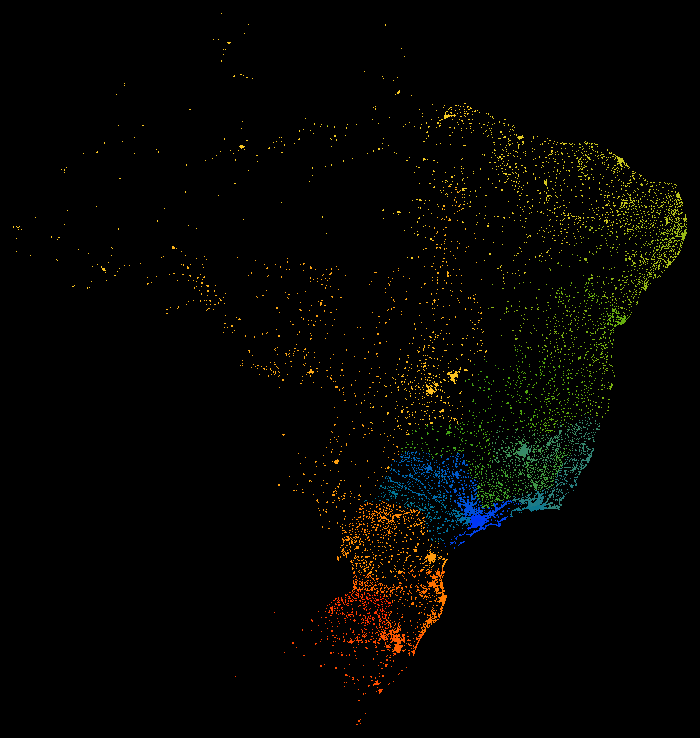

In [344]:
create_map(dtGeoMod, rainbow, ds.mean(agg_name),'CEP_brasil')

Focando no estado de São Paulo é perceptivel um grande numero de pedidos, representando aproximadamente 40% dos pedidos.

In [345]:
plot_map(dtGeoMod[dtGeoMod['geolocation_state'] == 'SP'], 'CEP no Estado de São Paulo', ds.min(agg_name), agg_name, cmap = rainbow)

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y geolocation_zip_code_prefix)

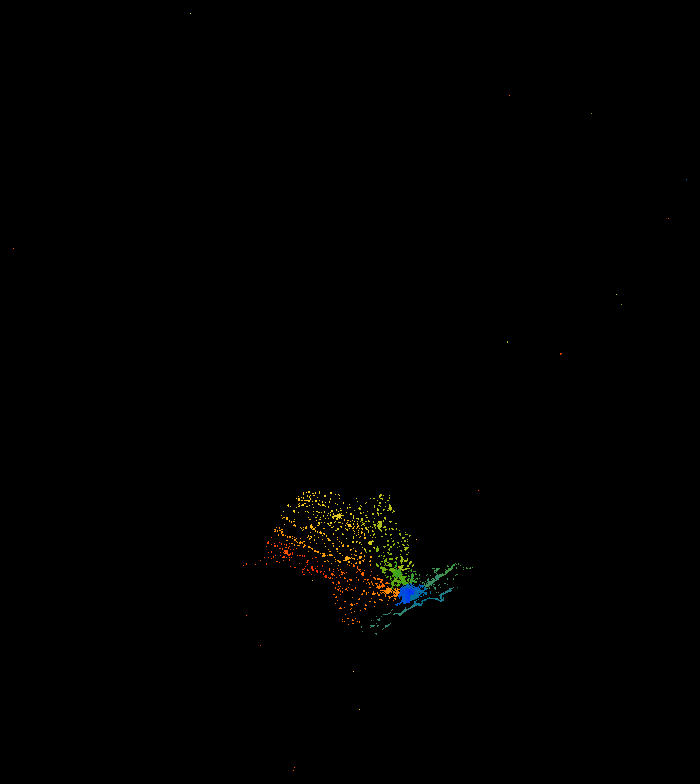

In [346]:
create_map(dtGeoMod[dtGeoMod['geolocation_state'] == 'SP'], rainbow, ds.mean(agg_name), 'ceps_SP_estado')

In [347]:
plot_map(dtGeoMod[dtGeoMod['geolocation_city'] == 'sao paulo'], 'CEP na Cidade de São Paulo', ds.min(agg_name), agg_name, cmap = rainbow)

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y geolocation_zip_code_prefix)

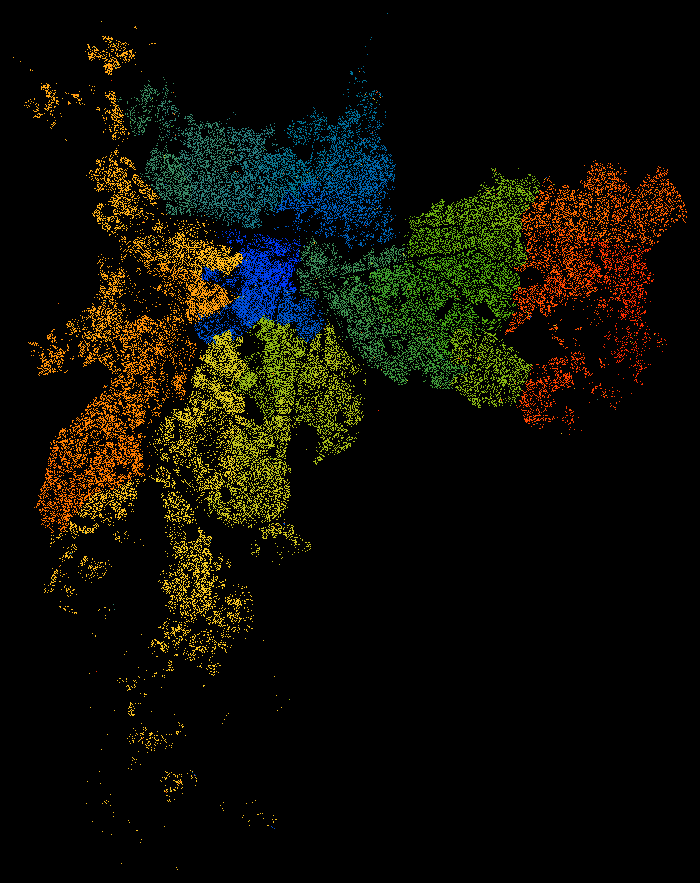

In [348]:
create_map(dtGeoMod[dtGeoMod['geolocation_city'] == 'sao paulo'], rainbow, ds.mean(agg_name), 'ceps_SP_cidade')

Focando no estado de Santa Catarina é claro uma diminuição brusca no numero de vendas, lembrando que SC é o 6 estado com mais vendas.

In [349]:
plot_map(dtGeoMod[dtGeoMod['geolocation_state'] == 'SC'], 'CEP no Estado de Santa Catarina', ds.min(agg_name), agg_name, cmap = rainbow)

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y geolocation_zip_code_prefix)

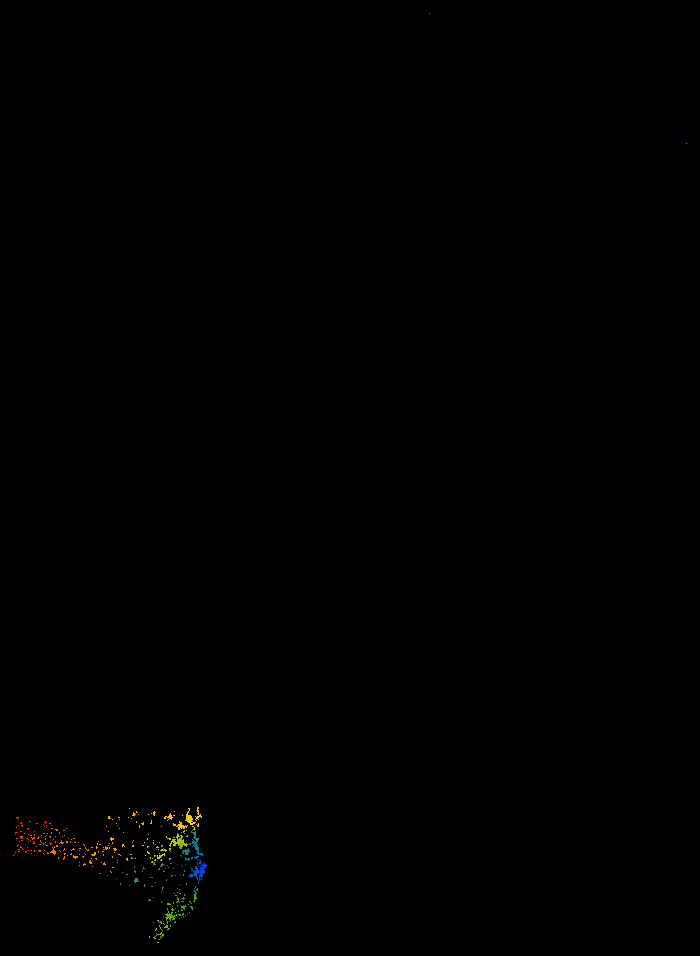

In [350]:
create_map(dtGeoMod[dtGeoMod['geolocation_state'] == 'SC'], rainbow, ds.mean(agg_name), 'ceps_SC_estado')

In [351]:
plot_map(dtGeoMod[dtGeoMod['geolocation_city'] == 'itajai'], 'CEP na Cidade de Itajaí', ds.min(agg_name), agg_name, cmap = rainbow)

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y geolocation_zip_code_prefix)

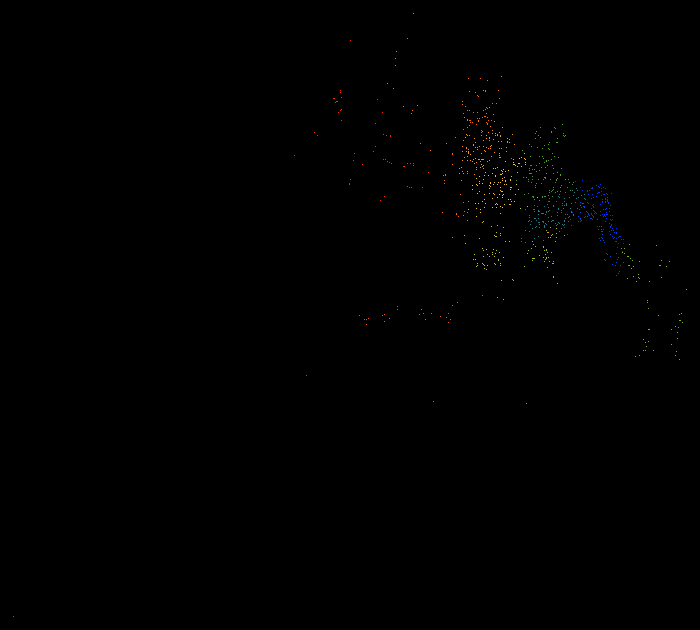

In [352]:
create_map(dtGeoMod[dtGeoMod['geolocation_city'] == 'itajai'], rainbow, ds.mean(agg_name), 'ceps_itajai_cidade')

In [353]:
plot_map(dtGeoMod[dtGeoMod['geolocation_city'] == 'rio de janeiro'], 'CEP na Cidade do Rio De Janeiro', ds.min(agg_name), agg_name, cmap = rainbow)

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y geolocation_zip_code_prefix)

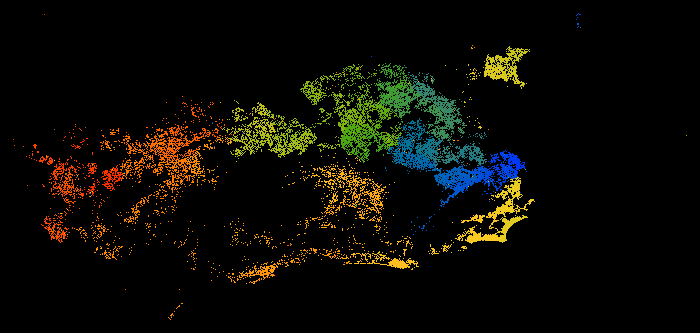

In [354]:
create_map(dtGeoMod[dtGeoMod['geolocation_city'] == 'rio de janeiro'], rainbow, ds.mean(agg_name), 'ceps_rio_de_janeiro_cidade')

## 8.3 Regiões com maior faturamento no Brasil

In [355]:
dtCustomers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,regiao
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,Sudeste
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,Sudeste
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,Sudeste
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,Sudeste
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,Sudeste


In [356]:
dtCustomersTemp = dtCustomers.copy()

In [357]:
dtCustomersTemp['customer_zip_code_prefix_3_digits'] = dtCustomersTemp['customer_zip_code_prefix'].str[0:3]
dtCustomersTemp['customer_zip_code_prefix_3_digits'] = dtCustomersTemp['customer_zip_code_prefix_3_digits'].astype(int)

dtGeoModBR = dtGeoMod.set_index('geolocation_zip_code_prefix_3_digits').copy()

In [358]:
dtOrderItems.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


In [359]:
dtOrdersTemp = dtOrders.merge(dtOrderItems, on='order_id')
dtOrdersTemp = dtOrdersTemp.merge(dtCustomersTemp, on='customer_id')
dtOrdersTemp = dtOrdersTemp.merge(dtOrderReviews, on = 'order_id')

In [360]:
dtFiltrado = dtOrdersTemp.groupby('customer_zip_code_prefix_3_digits')['price'].sum().to_frame()
revenue = dtGeoModBR.join(dtFiltrado)
agg_name = 'revenue'
revenue[agg_name] = revenue.price / 1000

Olhando para um heatmap de faturamento, é claro que os estados na região Sudeste possuem um faturamento superior em relação aos outros estados, ainda é visivel um faturamento alto na região Sul e uma distribuição grande pela região do Nordeste.

In [361]:
plot_map(revenue, 'Faturamento no Brasil (Em milhares de R$)', ds.mean(agg_name), agg_name, cmap=fire)

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y revenue)

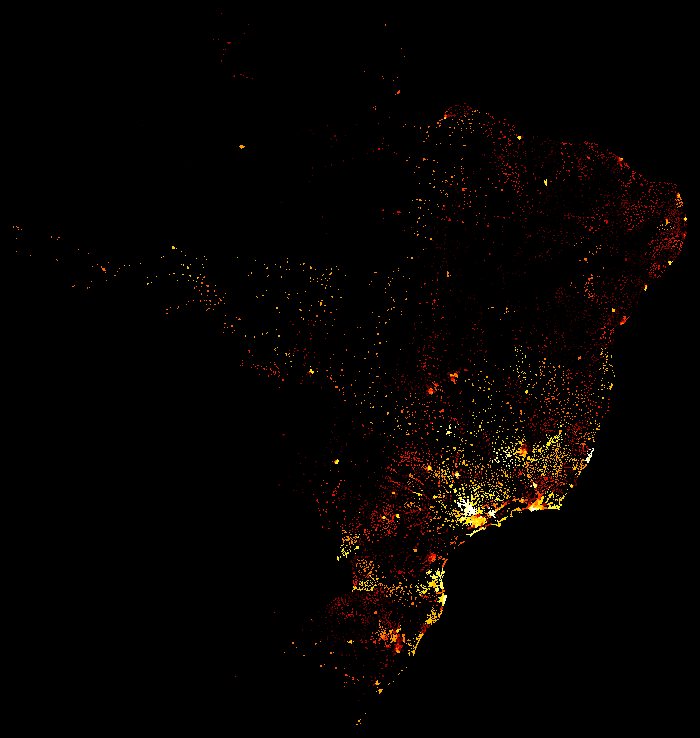

In [362]:
create_map(revenue, fire, ds.mean(agg_name), 'faturamento_brasil')

In [363]:
dtFiltrado = dtOrdersTemp.groupby('order_id').agg({'price': 'sum', 'customer_zip_code_prefix_3_digits': 'max'})
dtFiltrado = dtFiltrado.groupby('customer_zip_code_prefix_3_digits')['price'].mean().to_frame()
avg_ticket = dtGeoModBR.join(dtFiltrado)
agg_name = 'avg_ticket'
avg_ticket[agg_name] = avg_ticket.price

Já em relação ao Ticket Medio, é claro que as regiões do Nordeste possuem um ticket medio superior em relação ao Sudeste. É possível analisar que apesar de os estados do Nordeste possuirem um numero de pedidos menor, estão dispostos a realizar mais compras conjuntas. Isso pode se dar pelo baixo volume de compras que pode não ser representativo ou devido ao acumulo de diversos itens em unico pedido.

In [364]:
plot_map(avg_ticket, 'Ticket Medio em R$ no Brasil', ds.mean(agg_name), agg_name, cmap=bgy)

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y avg_ticket)

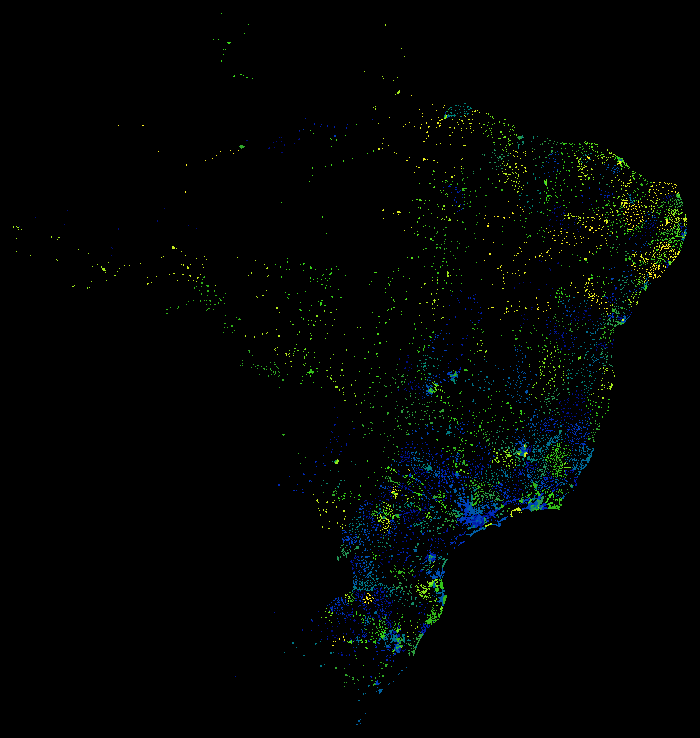

In [365]:
create_map(avg_ticket, bgy, ds.mean('avg_ticket'), 'ticket_medio_brasil')

## 8.4 Regiões com maior taxa de transporte em relação ao pedido

In [366]:
dtFiltrado = dtOrdersTemp.groupby('order_id').agg({'price': 'sum', 'freight_value': 'sum', 'customer_zip_code_prefix_3_digits': 'max'})
agg_name = 'freight_ratio'
dtFiltrado[agg_name] = dtFiltrado['freight_value'] / dtFiltrado['price']
dtFiltrado = dtFiltrado.groupby('customer_zip_code_prefix_3_digits')[agg_name].mean().to_frame()
freight_ratio = dtGeoModBR.join(dtFiltrado)

Mais uma vez é perceptivel que as regiões do Sudeste possuem uma taxa de transporte menor em relação ao pedido, isso se da pois a maioria das distribuidoras de carga e centrais de distribuição ficam localizadas nessa região. Assim é possível diminuir o valor do frete. Em contrapartida é visível que a região do Nordeste possui uma tendência a pagar mais caro pelo transporte, fazendo sentido com a relação feita anteriormente que os pedidos devem acumular mais produtos para compensar o valor do transporte.

In [367]:
plot_map(freight_ratio, 'Taxa de Transporte em Relação ao Pedido no Brasil', ds.mean(agg_name), agg_name, cmap=bgy)

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y freight_ratio)

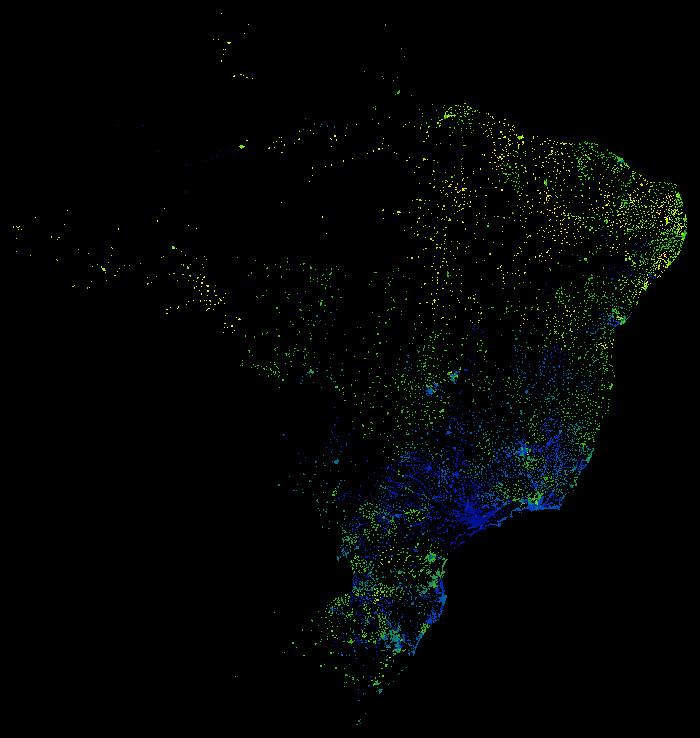

In [368]:
create_map(freight_ratio, bgy, ds.mean('freight_ratio'), 'taxa_transporte_em_relacao_ao_pedido_brasil')

## 8.5 Tempo Medio de Entrega

In [369]:
dtOrdersTemp['order_delivered_customer_date'] = pd.to_datetime(dtOrdersTemp['order_delivered_customer_date'])
dtOrdersTemp['order_estimated_delivery_date'] = pd.to_datetime(dtOrdersTemp['order_estimated_delivery_date'])
dtOrdersTemp['order_delivered_carrier_date'] = pd.to_datetime(dtOrdersTemp['order_delivered_carrier_date'])
dtOrdersTemp['actual_delivery_time'] = dtOrdersTemp['order_delivered_customer_date'] - dtOrdersTemp['order_delivered_carrier_date']
dtOrdersTemp['actual_delivery_time'] = dtOrdersTemp['actual_delivery_time'].dt.days

In [370]:
dtFiltrado = dtOrdersTemp.groupby('customer_zip_code_prefix_3_digits')['actual_delivery_time'].mean().to_frame()
delivery_time = dtGeoModBR.join(dtFiltrado)
agg_name = 'avg_delivery_time'
delivery_time[agg_name] = delivery_time['actual_delivery_time']

Analisando o mapa abaixo é perceptivel que a região do Sudeste possuem uma entrega mais rapida, também é visualizado que as região do Sul possui um leve aumento no prazo de entrega. Já os estados da região Norte e Nordeste possuem um aumento consideravel, levando a um frete mais caro e mais demorado para essas regiões.

In [371]:
plot_map(delivery_time, 'Tempo Medio de Entrega em Dias no Brasil', ds.mean(agg_name), agg_name, cmap=bjy)

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y avg_delivery_time)

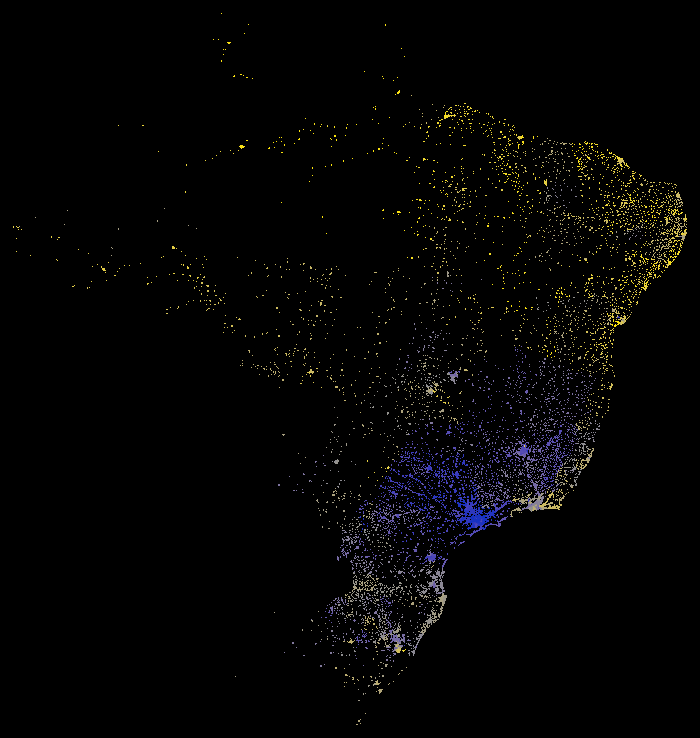

In [372]:
create_map(delivery_time, bjy, ds.mean(agg_name), 'tempo_medio_entrega_dias_brasil')

## 8.6 Review Medio Por Região

In [373]:
dtFiltrado = dtOrdersTemp.groupby('customer_zip_code_prefix_3_digits')['review_score'].mean().to_frame()
score = dtGeoModBR.join(dtFiltrado)
agg_name = 'avg_score'
score[agg_name] = score['review_score']

Analisando o grafico abaixo dos reviews realizados dos pedidos realizados no Brasil, é possível identificar que a região próxima ao Rio de Janeiro possui um acumulo maior de avaliações negativas, o mesmo serve para algumas regiões do Nordeste em sentido a região Norte. Já os pedidos na região Sul aparentam possuir uma maior taxa da avaliações positivas. 

In [374]:
plot_map(score, 'Review Médio No Brasil', ds.mean(agg_name), agg_name, cmap=bgy)

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y avg_score)

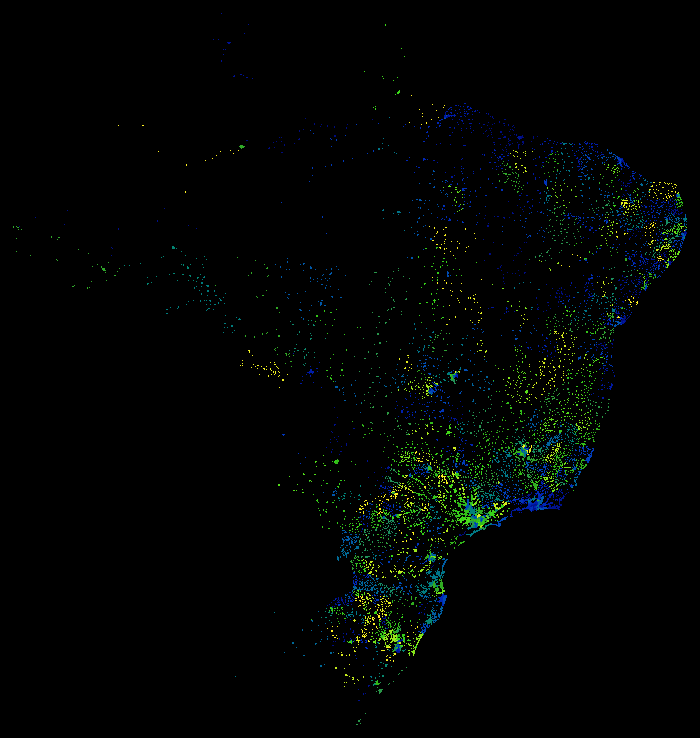

In [375]:
create_map(score, bgy, ds.mean(agg_name), 'review_medio_brasil')

# O resto é história